# **Setup**

In [1]:
!pip install -q tf_explain

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


In [1]:
import os
import numpy as np
import tf_keras as tfk
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow.data as tfd
import tensorflow.image as tfi
import cv2

from glob import glob
from tqdm import tqdm

from tf_keras.preprocessing.image import load_img, img_to_array
from tf_keras.applications.imagenet_utils import preprocess_input
from tf_keras import backend as K
from tf_keras.utils import load_img, img_to_array, get_custom_objects
from tf_keras.layers import (
    ReLU, Input, Layer, 
    Conv2D, Concatenate, 
    UpSampling2D, AveragePooling2D, 
    BatchNormalization,
    MaxPooling2D, Conv2DTranspose
)
from tf_keras.models import Sequential, Model
from tf_keras.applications import ResNet50
from tf_keras.callbacks import Callback, ModelCheckpoint, EarlyStopping
from tf_keras.utils import plot_model

from tf_explain.utils.display import grid_display, heatmap_display
from tf_explain.utils.saver import save_rgb

# **Data Preparation**

In [3]:
image_path = '/kaggle/input/image-and-mask-pythoplankton-dataset/segmentation/image'
mask_path = '/kaggle/input/image-and-mask-pythoplankton-dataset/segmentation/mask'

In [4]:
def load_image(path, IMAGE_SIZE=(192, 288)):
    image = load_img(path)
    image = img_to_array(image)
    image = tfi.resize(image, IMAGE_SIZE)
    image = tf.cast(image, tf.float32)
    image = image / 255.0
    
    return image

def load_images(paths, IMAGE_SIZE=(192, 288)):
    images = np.zeros((len(paths), IMAGE_SIZE[0], IMAGE_SIZE[1], 3))
    
    for i, path in tqdm(enumerate(paths), desc="Loading"):
        images[i] = load_image(path, IMAGE_SIZE=IMAGE_SIZE)
        
    return images

def load_data(image_path, mask_path, trim=None, IMAGE_SIZE=(192, 288), BATCH_SIZE=8):
    image_paths = glob(os.path.join(image_path, "*.jpg"))
    mask_paths = glob(os.path.join(mask_path, "*.jpg"))
    
    if trim is not None:
        image_paths = image_paths[trim[0]:trim[1]]
        mask_paths = mask_paths[trim[0]:trim[1]]
    
    images = load_images(image_paths, IMAGE_SIZE=IMAGE_SIZE)
    masks = load_images(mask_paths, IMAGE_SIZE=IMAGE_SIZE)
    
    data = tfd.Dataset.from_tensor_slices((images, masks))
    data = data.batch(BATCH_SIZE, drop_remainder=True)
    data = data.shuffle(1000).prefetch(tfd.AUTOTUNE)
    
    return data, images, masks

In [6]:
train_ds, train_images, train_masks = load_data(image_path, mask_path, trim=[100, 560])
valid_ds, val_images, val_masks = load_data(image_path, mask_path, trim=[0, 80])
test_ds, test_images, test_masks = load_data(image_path, mask_path, trim=[80, 100])

Loading: 460it [00:03, 117.04it/s]
Loading: 460it [00:03, 142.36it/s]
Loading: 80it [00:00, 112.40it/s]
Loading: 80it [00:00, 129.81it/s]
Loading: 20it [00:00, 106.82it/s]
Loading: 20it [00:00, 130.63it/s]


# **Data Visualization**

In [7]:
class GradCAM:
    
    def explain(
        self, validation_data, model, class_index,
        layer_name=None,
        use_guided_grads=True,
        colormap=cv2.COLORMAP_VIRIDIS,
        image_weight=0.7,
    ):
        images, _ = validation_data

        if layer_name is None:
            layer_name = self.infer_grad_cam_target_layer(model)

        outputs, grads = GradCAM.get_gradients_and_filters(
            model, images, layer_name, class_index, use_guided_grads
        )

        cams = GradCAM.generate_ponderated_output(outputs, grads)

        heatmaps = np.array(
            [
                heatmap_display(cam.numpy(), image, colormap, image_weight)
                for cam, image in zip(cams, images)
            ]
        )

        grid = grid_display(heatmaps)

        return grid

    @staticmethod
    def infer_grad_cam_target_layer(model):
        for layer in reversed(model.layers):
            if len(layer.output_shape) == 4:
                return layer.name

        raise ValueError(
            "Model does not seem to contain 4D layer. Grad CAM cannot be applied."
        )

    @staticmethod
    def get_gradients_and_filters(
        model, images, layer_name, class_index, use_guided_grads
    ):
        grad_model = tfk.models.Model(
            [model.inputs], [model.get_layer(layer_name).output, model.output]
        )

        with tf.GradientTape() as tape:
            inputs = tf.cast(images, tf.float32)
            tape.watch(inputs)
            conv_outputs, predictions = grad_model(inputs)
            loss = predictions[:, class_index]

        grads = tape.gradient(loss, conv_outputs)

        if use_guided_grads:
            grads = (
                tf.cast(conv_outputs > 0, "float32")
                * tf.cast(grads > 0, "float32")
                * grads
            )

        return conv_outputs, grads

    @staticmethod
    def generate_ponderated_output(outputs, grads):
        maps = [
            GradCAM.ponderate_output(output, grad)
            for output, grad in zip(outputs, grads)
        ]

        return maps

    @staticmethod
    def ponderate_output(output, grad):
        weights = tf.reduce_mean(grad, axis=(0, 1))

        cam = tf.reduce_sum(tf.multiply(weights, output), axis=-1)

        return cam

    def save(self, grid, output_dir, output_name):
        save_rgb(grid, output_dir, output_name)

In [8]:
def show_images(data, model=None, explain=False, n_images=6, SIZE=(25, 10)):
    n_cols = 5 if model and explain else 4 if model else 3
    
    for plot_no in range(1, n_images + 1):
        for images, masks in iter(data):
            id = np.random.randint(len(images))
            image, mask = images[id], masks[id]

            if model:
                pred_mask = model.predict(image[np.newaxis, ...])[0]
                plt.figure(figsize=SIZE)
                
                plt.subplot(1, n_cols, 1)
                plt.imshow(image)
                plt.axis('off')
                plt.title("Original Image")

                plt.subplot(1, n_cols, 2)
                plt.imshow(mask)
                plt.axis('off')
                plt.title('Original Mask')

                plt.subplot(1, n_cols, 3)
                plt.imshow(pred_mask)
                plt.axis('off')
                plt.title("Predicted Mask")

                plt.subplot(1, n_cols, 4)
                plt.imshow(image)
                plt.imshow(pred_mask, alpha=0.4)
                plt.axis('off')
                plt.title("Overlaped Prediction")

                if explain:
                    cam = GradCAM().explain(
                        validation_data=(val_images[id][np.newaxis, ...], val_masks[id]),
                        model=model,
                        class_index=1,
                        layer_name="Top-ConvBlock-2",
                        image_weight=0.5
                    )
                    plt.subplot(1, n_cols, 5)
                    plt.imshow(cam)
                    plt.axis('off')
                    plt.title("Grad CAM")
                    
                plt.show()
                
            else:
                plt.figure(figsize=SIZE)
                
                plt.subplot(1, n_cols, 1)
                plt.imshow(image)
                plt.axis('off')
                plt.title("Original Image")

                plt.subplot(1, n_cols, 2)
                plt.imshow(mask)
                plt.axis('off')
                plt.title('Original Mask')

                plt.subplot(1, n_cols, 3)
                plt.imshow(image)
                plt.imshow(mask, alpha=0.4)
                plt.axis('off')
                plt.title("Overlaped Image")
                
                plt.show()
            
            break

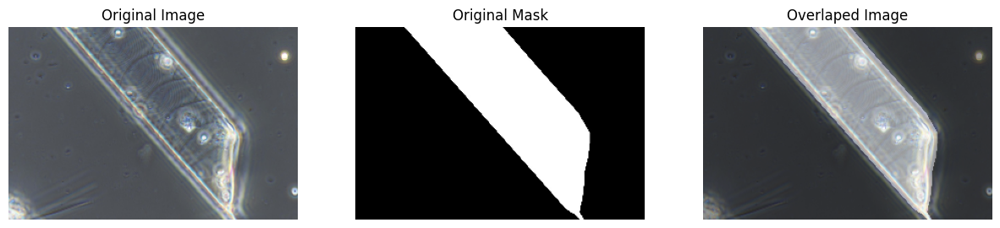

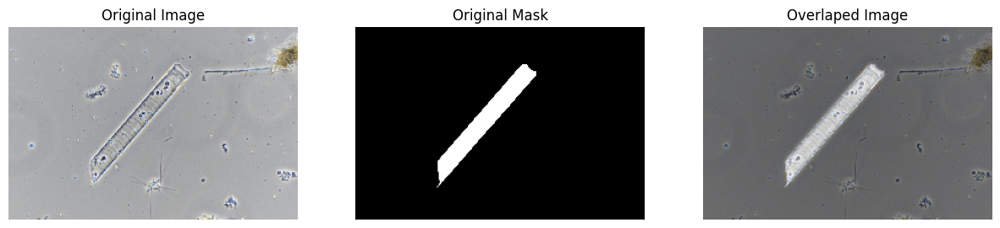

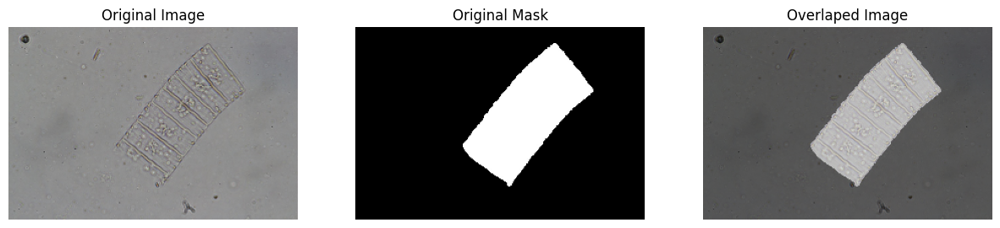

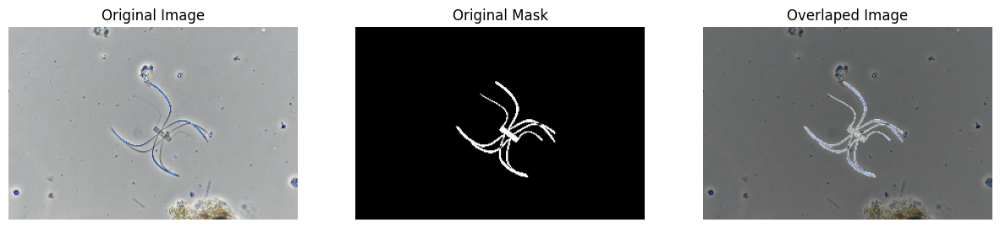

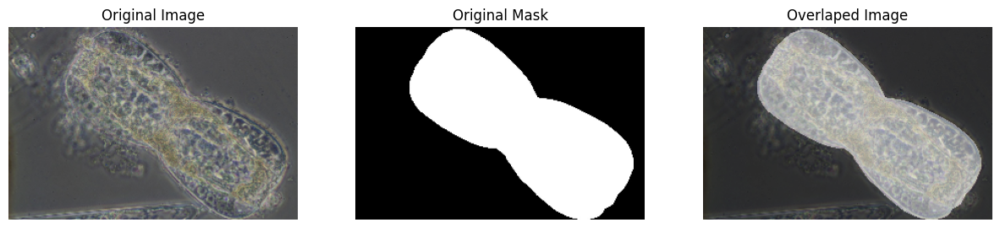

In [6]:
show_images(data=train_ds, n_images=5, SIZE=(15, 5))

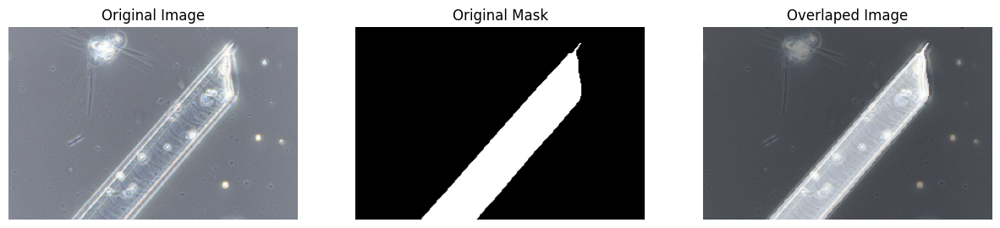

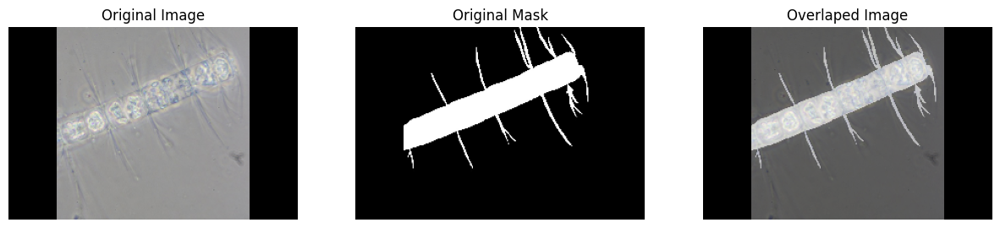

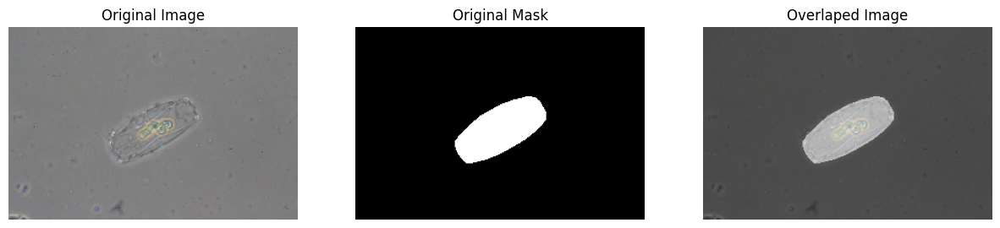

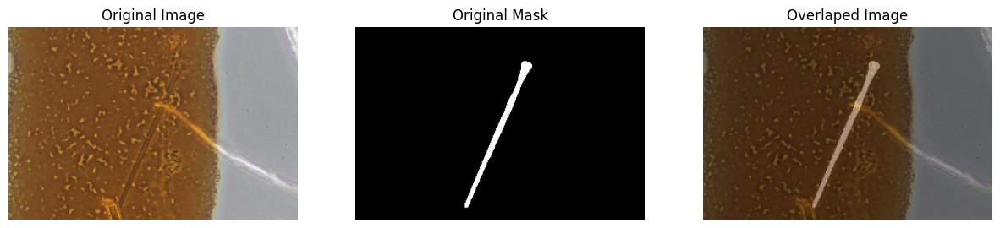

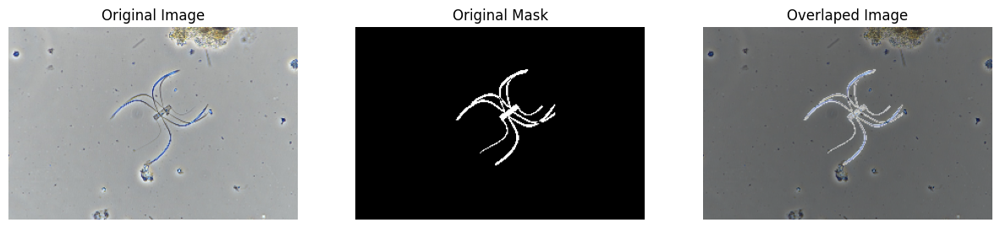

In [7]:
show_images(data=valid_ds, n_images=5, SIZE=(15, 5))

# **DeepLabV3+**

In [8]:
def ConvBlock(block_input, name, num_filters=256, kernel_size=3, dilation_rate=1, use_bias=False):
    x = Conv2D(
        num_filters,
        kernel_size=kernel_size,
        dilation_rate=dilation_rate,
        padding="same",
        use_bias=use_bias,
        kernel_initializer='he_normal'
    )(block_input)
    x = BatchNormalization()(x)
    x = ReLU(name=name)(x)
    return x

def AtrousSpatialPyramidPooling(X):
    B, H, W, C = X.shape
    
    image_pool = AveragePooling2D(pool_size=(H, W), name="ASPP-AvgPool")(X)
    image_pool = ConvBlock(image_pool, kernel_size=1, name="ASPP-ImagePool-CB")
    image_pool = UpSampling2D(
        size=(H//image_pool.shape[1], W//image_pool.shape[2]), 
        name="ASPP-ImagePool-UpSample"
    )(image_pool)
    
    conv_1  = ConvBlock(X, kernel_size=1, dilation_rate=1, name="ASPP-CB-1")
    conv_6  = ConvBlock(X, kernel_size=3, dilation_rate=6, name="ASPP-CB-6")
    conv_12 = ConvBlock(X, kernel_size=3, dilation_rate=12, name="ASPP-CB-12")
    conv_18 = ConvBlock(X, kernel_size=3, dilation_rate=18, name="ASPP-CB-18")
    
    combined = Concatenate(name="ASPP-Combine")([image_pool, conv_1, conv_6, conv_12, conv_18])
    processed = ConvBlock(combined, kernel_size=1, name="ASPP-Net")
    
    return processed

In [9]:
def DeepLabV3Plus(IMAGE_SIZE_1=192, IMAGE_SIZE_2=288):
    tfk.backend.clear_session()

    # Input
    InputL = Input(shape=(IMAGE_SIZE_1, IMAGE_SIZE_2, 3), name="InputLayer")

    # Base Model
    resnet50 = ResNet50(include_top=False, weights='imagenet', input_tensor=InputL)

    # ASPP Phase
    DCNN = resnet50.get_layer('conv4_block6_2_relu').output
    ASPP = AtrousSpatialPyramidPooling(DCNN)
    ASPP = UpSampling2D(size=(IMAGE_SIZE_1//ASPP.shape[1]//4, IMAGE_SIZE_2//ASPP.shape[2]//4), name="AtrousSpatial")(ASPP)

    # LLF Phase
    DCNN = resnet50.get_layer('conv2_block3_2_relu').output
    LLF = ConvBlock(DCNN, num_filters=48, kernel_size=1, name="LLF-ConvBlock")

    # Combined
    combined = Concatenate(axis=-1, name="Combine-LLF-ASPP")([ASPP, LLF])
    features = ConvBlock(combined, name="Top-ConvBlock-1")
    features = ConvBlock(features, name="Top-ConvBlock-2")
    
    # Final Upsampling to match the original input size
    upsample = UpSampling2D(size=(IMAGE_SIZE_1//features.shape[1], IMAGE_SIZE_2//features.shape[2]), interpolation='bilinear', name="Top-UpSample")(features)

    # Output Mask
    PredMask = Conv2D(3, kernel_size=3, strides=1, padding='same', activation='sigmoid', use_bias=False, name="OutputMask")(upsample)

    # DeepLabV3+ Model
    model = Model(InputL, PredMask, name="DeepLabV3-Plus")
    return model

model = DeepLabV3Plus()

94765736/94765736 [==============================] - 1s 0us/step


## **DeepLab Model Training**

Epoch 1/50
57/57 [==============================] - 59s 272ms/step - loss: 0.1265 - binary_io_u: 0.7160 - val_loss: 0.3662 - val_binary_io_u: 0.4578
Epoch 2/50
57/57 [==============================] - 9s 156ms/step - loss: 0.0736 - binary_io_u: 0.8197 - val_loss: 0.3604 - val_binary_io_u: 0.4579
Epoch 3/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0543 - binary_io_u: 0.8597 - val_loss: 0.7125 - val_binary_io_u: 0.4578
Epoch 4/50
57/57 [==============================] - 9s 155ms/step - loss: 0.0539 - binary_io_u: 0.8646 - val_loss: 0.4744 - val_binary_io_u: 0.4578
Epoch 5/50
1/1 [==============================] - 6s 6s/step- loss: 0.0482 - binary_io_u: 0.87


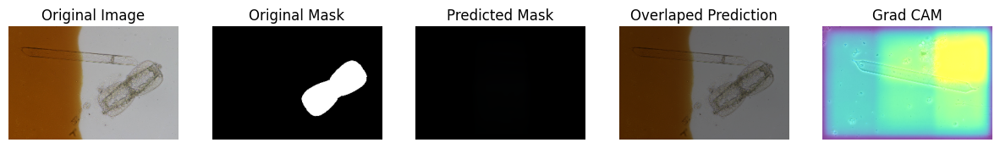

1/1 [==============================] - 0s 24ms/step


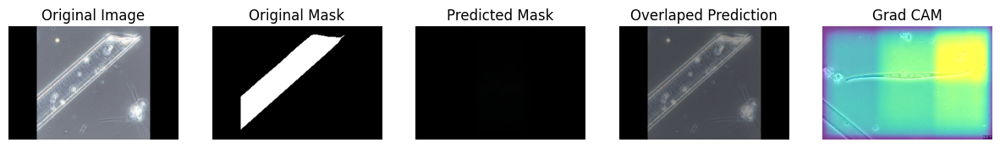

1/1 [==============================] - 0s 24ms/step


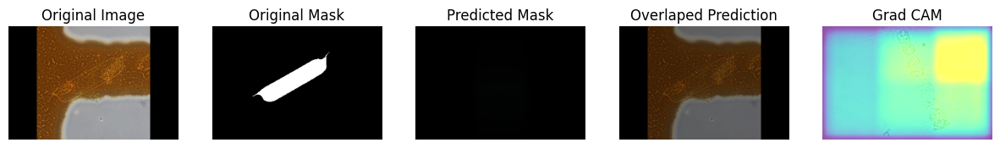

1/1 [==============================] - 0s 23ms/step


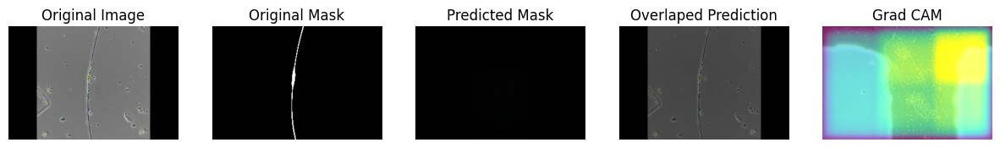

1/1 [==============================] - 0s 24ms/step


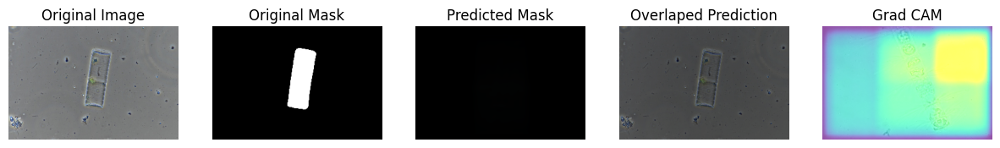

57/57 [==============================] - 20s 351ms/step - loss: 0.0482 - binary_io_u: 0.8769 - val_loss: 0.5144 - val_binary_io_u: 0.4578
Epoch 6/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0349 - binary_io_u: 0.9054 - val_loss: 0.5825 - val_binary_io_u: 0.4578
Epoch 7/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0259 - binary_io_u: 0.9222 - val_loss: 0.4155 - val_binary_io_u: 0.4578
Epoch 8/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0212 - binary_io_u: 0.9305 - val_loss: 0.5823 - val_binary_io_u: 0.4578
Epoch 9/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0183 - binary_io_u: 0.9356 - val_loss: 0.7190 - val_binary_io_u: 0.4578
Epoch 10/50
1/1 [==============================] - 0s 24ms/steploss: 0.0172 - binary_io_u: 0.93


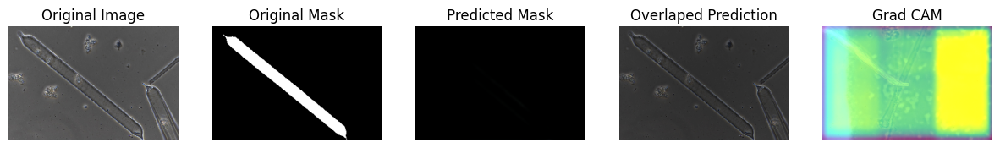

1/1 [==============================] - 0s 24ms/step


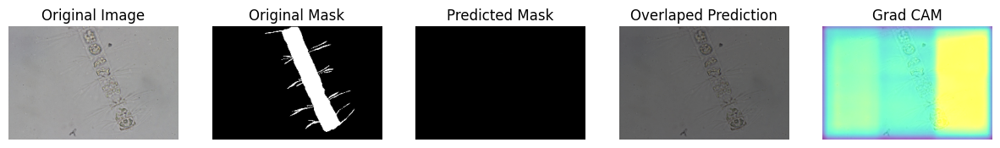

1/1 [==============================] - 0s 25ms/step


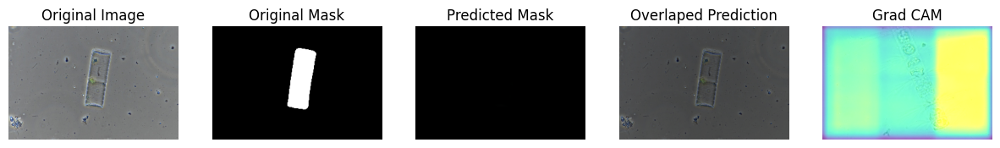

1/1 [==============================] - 0s 24ms/step


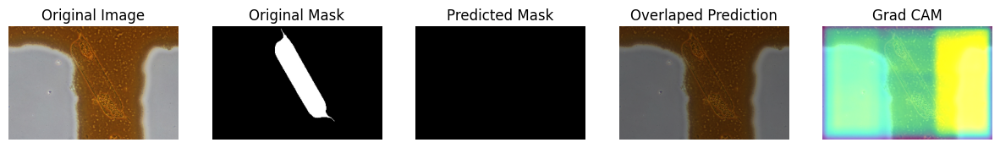

1/1 [==============================] - 0s 24ms/step


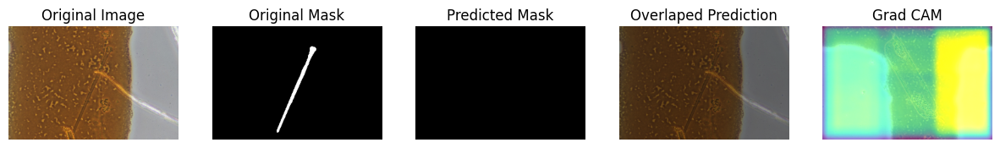

57/57 [==============================] - 13s 225ms/step - loss: 0.0172 - binary_io_u: 0.9376 - val_loss: 0.6840 - val_binary_io_u: 0.4579
Epoch 11/50
57/57 [==============================] - 9s 155ms/step - loss: 0.0172 - binary_io_u: 0.9377 - val_loss: 0.5385 - val_binary_io_u: 0.4583
Epoch 12/50
57/57 [==============================] - 9s 156ms/step - loss: 0.0149 - binary_io_u: 0.9413 - val_loss: 0.5251 - val_binary_io_u: 0.4661
Epoch 13/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0147 - binary_io_u: 0.9420 - val_loss: 0.4450 - val_binary_io_u: 0.4702
Epoch 14/50
57/57 [==============================] - 10s 165ms/step - loss: 0.0141 - binary_io_u: 0.9426 - val_loss: 0.3749 - val_binary_io_u: 0.4826
Epoch 15/50
1/1 [==============================] - 0s 24ms/steploss: 0.0128 - binary_io_u: 0.94


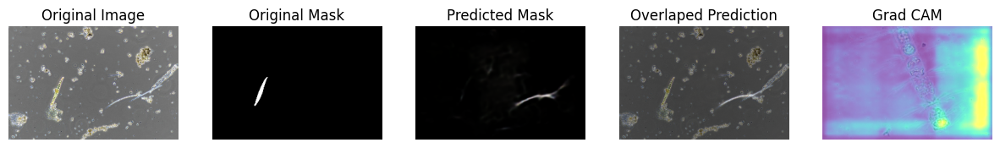

1/1 [==============================] - 0s 23ms/step


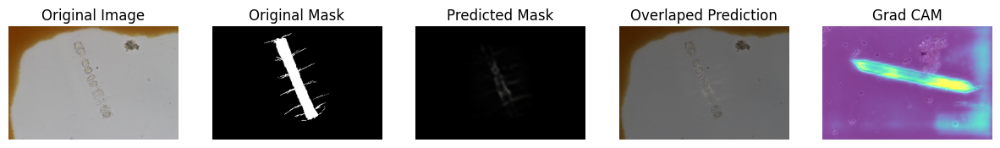

1/1 [==============================] - 0s 25ms/step


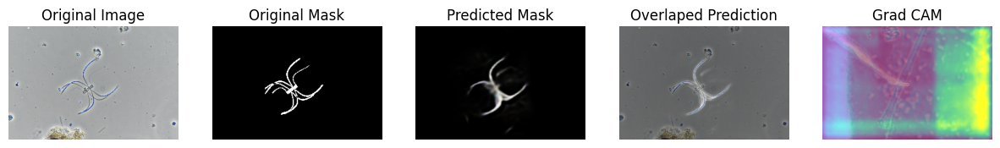

1/1 [==============================] - 0s 24ms/step


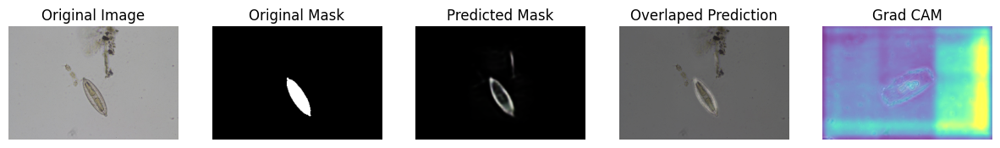

1/1 [==============================] - 0s 24ms/step


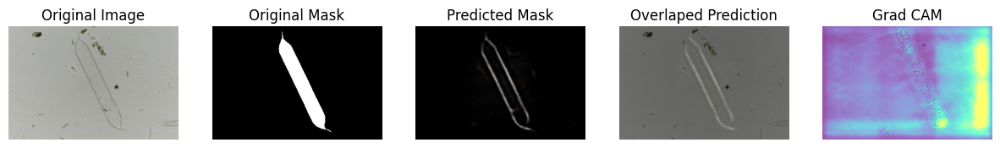

57/57 [==============================] - 12s 218ms/step - loss: 0.0128 - binary_io_u: 0.9445 - val_loss: 0.2358 - val_binary_io_u: 0.5537
Epoch 16/50
57/57 [==============================] - 9s 153ms/step - loss: 0.0122 - binary_io_u: 0.9459 - val_loss: 0.1931 - val_binary_io_u: 0.6677
Epoch 17/50
57/57 [==============================] - 9s 155ms/step - loss: 0.0124 - binary_io_u: 0.9447 - val_loss: 0.1228 - val_binary_io_u: 0.8008
Epoch 18/50
57/57 [==============================] - 9s 153ms/step - loss: 0.0115 - binary_io_u: 0.9464 - val_loss: 0.0937 - val_binary_io_u: 0.8578
Epoch 19/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0109 - binary_io_u: 0.9475 - val_loss: 0.0703 - val_binary_io_u: 0.8861
Epoch 20/50
1/1 [==============================] - 0s 24ms/steploss: 0.0107 - binary_io_u: 0.94


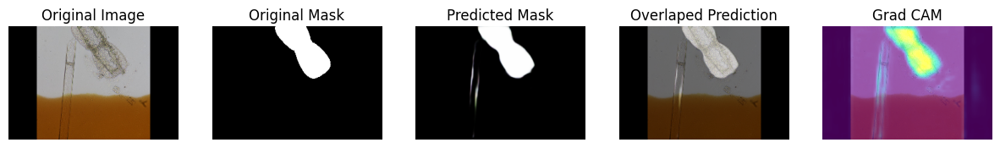

1/1 [==============================] - 0s 24ms/step


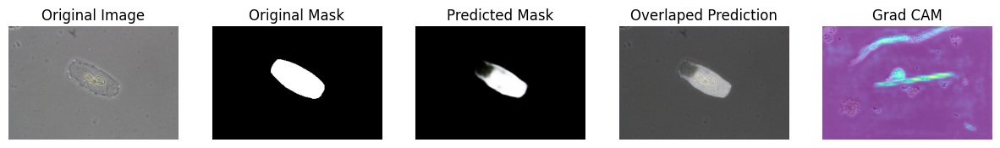

1/1 [==============================] - 0s 23ms/step


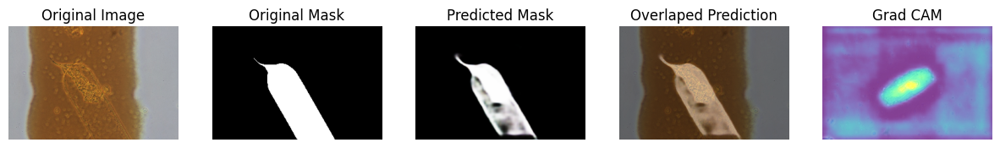

1/1 [==============================] - 0s 23ms/step


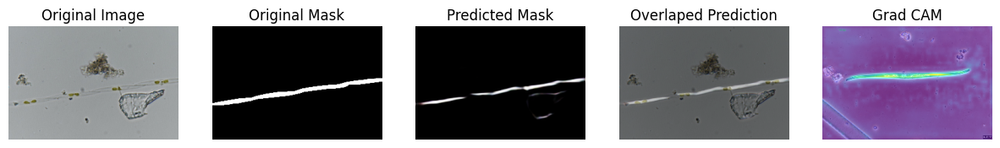

1/1 [==============================] - 0s 23ms/step


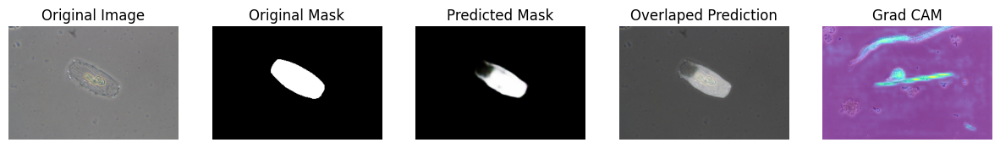

57/57 [==============================] - 13s 227ms/step - loss: 0.0107 - binary_io_u: 0.9476 - val_loss: 0.0409 - val_binary_io_u: 0.9198
Epoch 21/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0107 - binary_io_u: 0.9475 - val_loss: 0.0350 - val_binary_io_u: 0.9218
Epoch 22/50
57/57 [==============================] - 9s 153ms/step - loss: 0.0112 - binary_io_u: 0.9464 - val_loss: 0.0421 - val_binary_io_u: 0.9207
Epoch 23/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0109 - binary_io_u: 0.9474 - val_loss: 0.0274 - val_binary_io_u: 0.9281
Epoch 24/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0597 - binary_io_u: 0.8455 - val_loss: 4.7371 - val_binary_io_u: 0.4569
Epoch 25/50
1/1 [==============================] - 0s 24ms/steploss: 0.0834 - binary_io_u: 0.79


/opt/conda/lib/python3.10/site-packages/tf_explain/utils/display.py:112: RuntimeWarning: invalid value encountered in divide
  heatmap = (heatmap - np.min(heatmap)) / (heatmap.max() - heatmap.min())
/opt/conda/lib/python3.10/site-packages/tf_explain/utils/display.py:115: RuntimeWarning: invalid value encountered in cast
  cv2.cvtColor((heatmap * 255).astype("uint8"), cv2.COLOR_GRAY2BGR), colormap


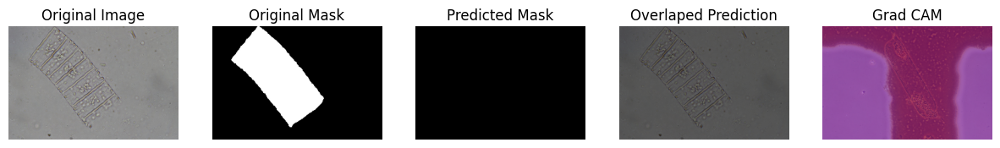

1/1 [==============================] - 0s 33ms/step


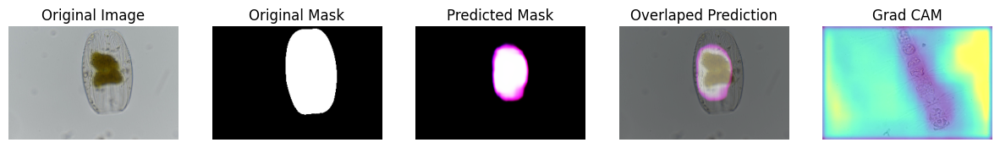

1/1 [==============================] - 0s 25ms/step


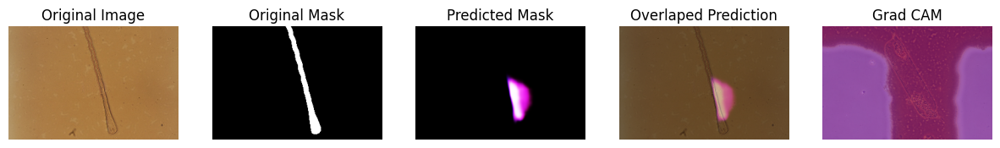

1/1 [==============================] - 0s 25ms/step


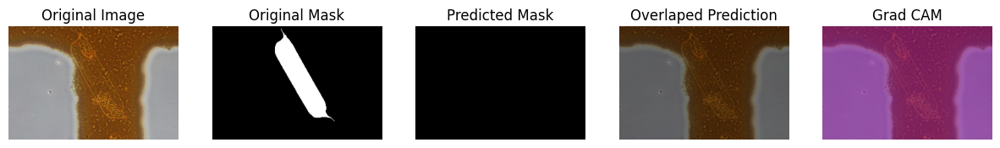

1/1 [==============================] - 0s 22ms/step


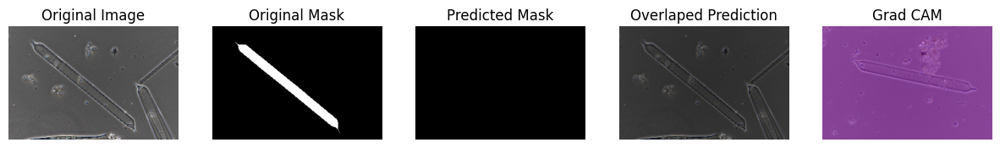

57/57 [==============================] - 14s 238ms/step - loss: 0.0834 - binary_io_u: 0.7975 - val_loss: 67.5502 - val_binary_io_u: 0.4810
Epoch 26/50
57/57 [==============================] - 9s 153ms/step - loss: 0.0575 - binary_io_u: 0.8529 - val_loss: 1.3899 - val_binary_io_u: 0.4905
Epoch 27/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0453 - binary_io_u: 0.8825 - val_loss: 0.2616 - val_binary_io_u: 0.6129
Epoch 28/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0366 - binary_io_u: 0.8997 - val_loss: 0.1572 - val_binary_io_u: 0.7219
Epoch 29/50
57/57 [==============================] - 9s 153ms/step - loss: 0.0274 - binary_io_u: 0.9169 - val_loss: 0.0969 - val_binary_io_u: 0.8274
Epoch 30/50
1/1 [==============================] - 0s 24ms/steploss: 0.0214 - binary_io_u: 0.93


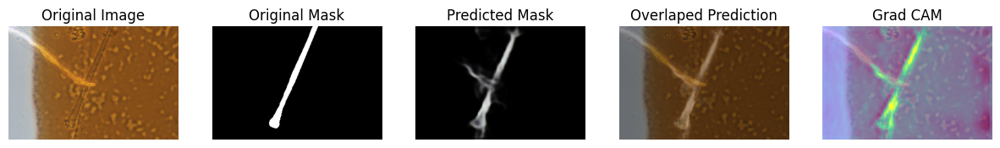

1/1 [==============================] - 0s 25ms/step


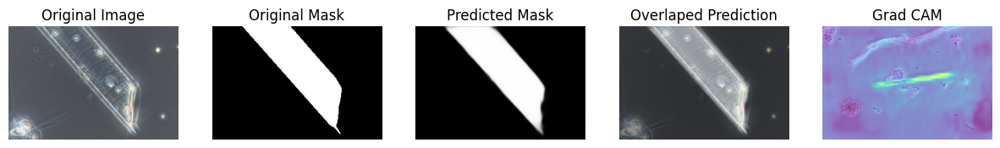

1/1 [==============================] - 0s 26ms/step


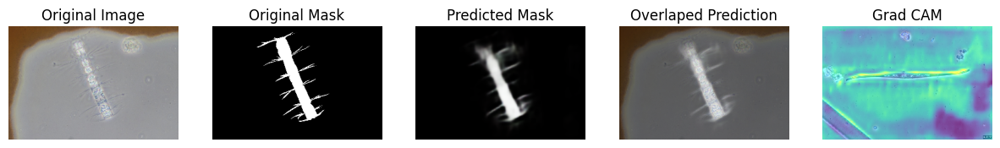

1/1 [==============================] - 0s 26ms/step


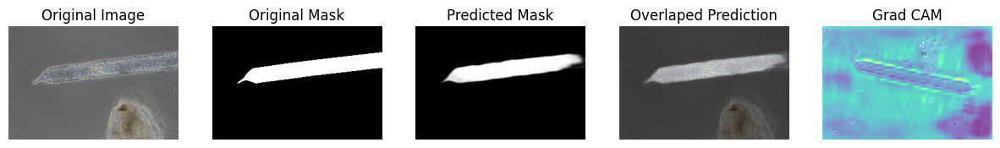

1/1 [==============================] - 0s 23ms/step


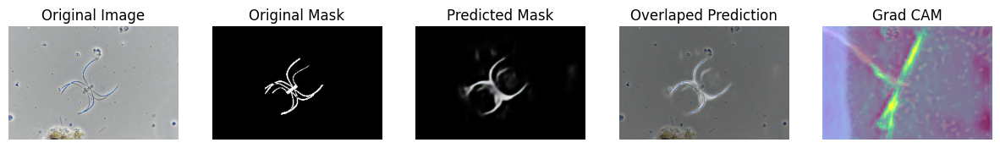

57/57 [==============================] - 13s 224ms/step - loss: 0.0214 - binary_io_u: 0.9311 - val_loss: 0.0528 - val_binary_io_u: 0.8895
Epoch 31/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0179 - binary_io_u: 0.9354 - val_loss: 0.0625 - val_binary_io_u: 0.8841
Epoch 32/50
57/57 [==============================] - 9s 155ms/step - loss: 0.0157 - binary_io_u: 0.9396 - val_loss: 0.0389 - val_binary_io_u: 0.9143
Epoch 33/50
57/57 [==============================] - 9s 156ms/step - loss: 0.0143 - binary_io_u: 0.9421 - val_loss: 0.0341 - val_binary_io_u: 0.9199
Epoch 34/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0135 - binary_io_u: 0.9435 - val_loss: 0.0309 - val_binary_io_u: 0.9272
Epoch 35/50
1/1 [==============================] - 0s 24ms/steploss: 0.0126 - binary_io_u: 0.94


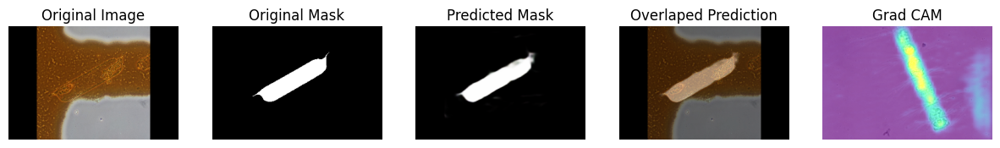

1/1 [==============================] - 0s 24ms/step


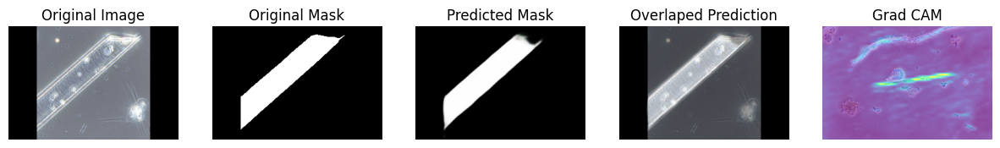

1/1 [==============================] - 0s 23ms/step


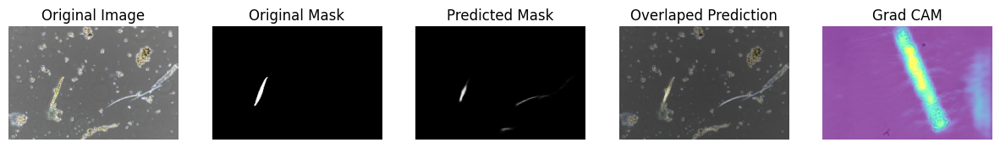

1/1 [==============================] - 0s 27ms/step


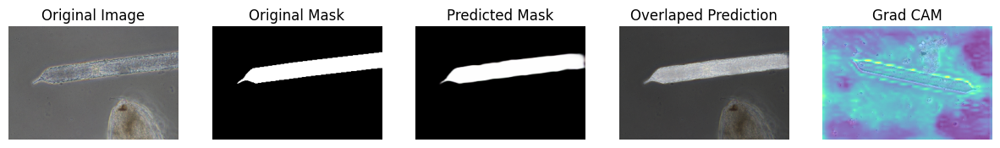

1/1 [==============================] - 0s 26ms/step


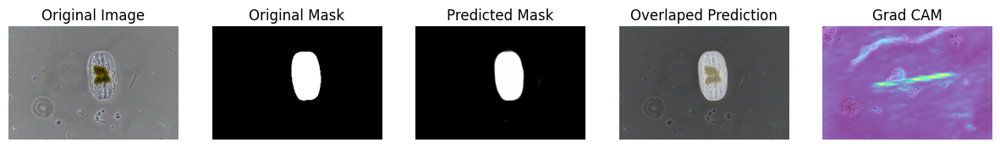

57/57 [==============================] - 13s 223ms/step - loss: 0.0126 - binary_io_u: 0.9450 - val_loss: 0.0323 - val_binary_io_u: 0.9220
Epoch 36/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0119 - binary_io_u: 0.9457 - val_loss: 0.0332 - val_binary_io_u: 0.9241
Epoch 37/50
57/57 [==============================] - 9s 155ms/step - loss: 0.0116 - binary_io_u: 0.9459 - val_loss: 0.0371 - val_binary_io_u: 0.9202
Epoch 38/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0116 - binary_io_u: 0.9464 - val_loss: 0.0311 - val_binary_io_u: 0.9247
Epoch 39/50
57/57 [==============================] - 9s 155ms/step - loss: 0.0114 - binary_io_u: 0.9466 - val_loss: 0.0619 - val_binary_io_u: 0.8956
Epoch 40/50
1/1 [==============================] - 0s 24ms/steploss: 0.0107 - binary_io_u: 0.94


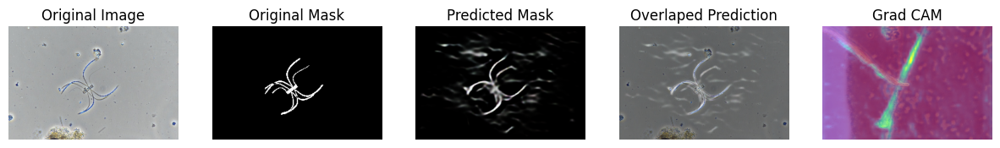

1/1 [==============================] - 0s 24ms/step


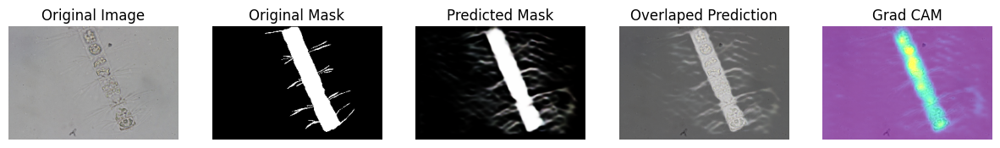

1/1 [==============================] - 0s 24ms/step


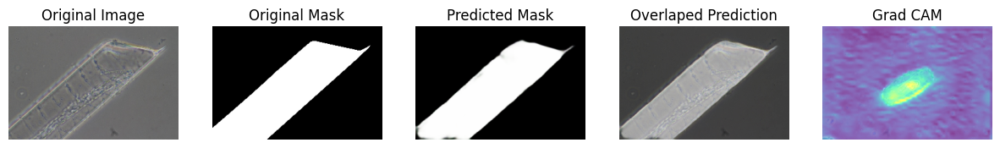

1/1 [==============================] - 0s 24ms/step


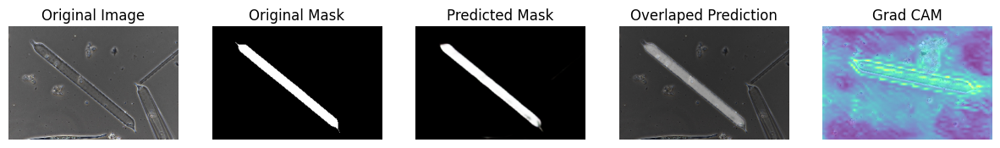

1/1 [==============================] - 0s 25ms/step


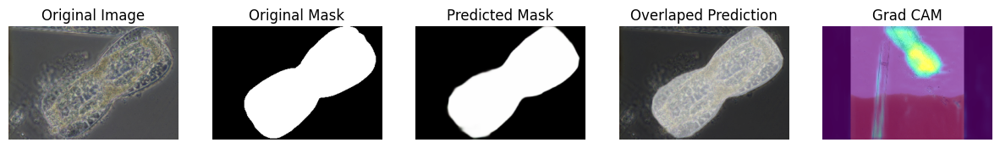

57/57 [==============================] - 13s 233ms/step - loss: 0.0107 - binary_io_u: 0.9475 - val_loss: 0.0410 - val_binary_io_u: 0.9206
Epoch 41/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0107 - binary_io_u: 0.9475 - val_loss: 0.0428 - val_binary_io_u: 0.9184
Epoch 42/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0104 - binary_io_u: 0.9481 - val_loss: 0.0511 - val_binary_io_u: 0.9112
Epoch 43/50
57/57 [==============================] - 9s 155ms/step - loss: 0.0102 - binary_io_u: 0.9483 - val_loss: 0.0419 - val_binary_io_u: 0.9153
Epoch 44/50
57/57 [==============================] - 9s 153ms/step - loss: 0.0103 - binary_io_u: 0.9479 - val_loss: 0.0355 - val_binary_io_u: 0.9275
Epoch 45/50
1/1 [==============================] - 0s 25ms/steploss: 0.0098 - binary_io_u: 0.94


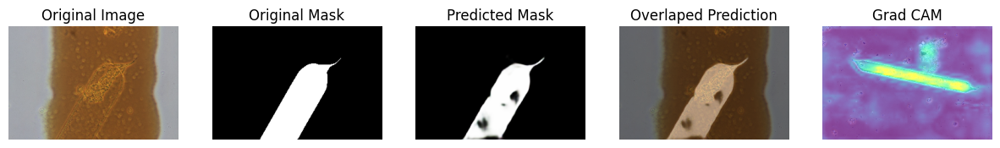

1/1 [==============================] - 0s 24ms/step


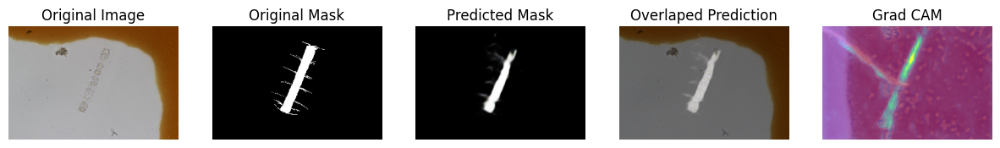

1/1 [==============================] - 0s 23ms/step


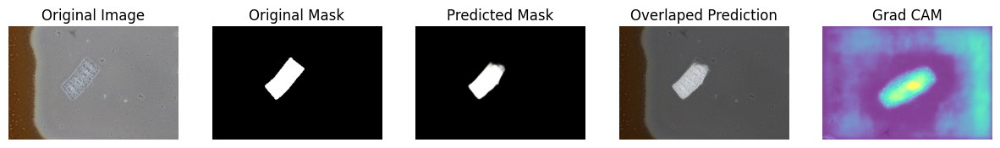

1/1 [==============================] - 0s 23ms/step


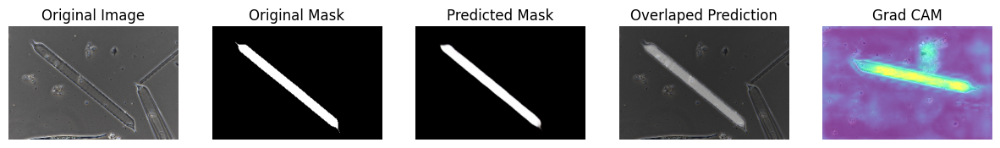

1/1 [==============================] - 0s 22ms/step


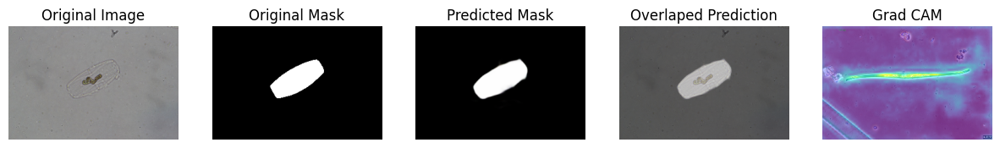

57/57 [==============================] - 13s 231ms/step - loss: 0.0098 - binary_io_u: 0.9485 - val_loss: 0.0401 - val_binary_io_u: 0.9214
Epoch 46/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0094 - binary_io_u: 0.9495 - val_loss: 0.0455 - val_binary_io_u: 0.9160
Epoch 47/50
57/57 [==============================] - 9s 155ms/step - loss: 0.0092 - binary_io_u: 0.9494 - val_loss: 0.0411 - val_binary_io_u: 0.9225
Epoch 48/50
57/57 [==============================] - 9s 154ms/step - loss: 0.0099 - binary_io_u: 0.9483 - val_loss: 0.0372 - val_binary_io_u: 0.9269
Epoch 49/50
57/57 [==============================] - 9s 156ms/step - loss: 0.0096 - binary_io_u: 0.9490 - val_loss: 0.0383 - val_binary_io_u: 0.9258
Epoch 50/50
1/1 [==============================] - 0s 23ms/steploss: 0.0092 - binary_io_u: 0.94


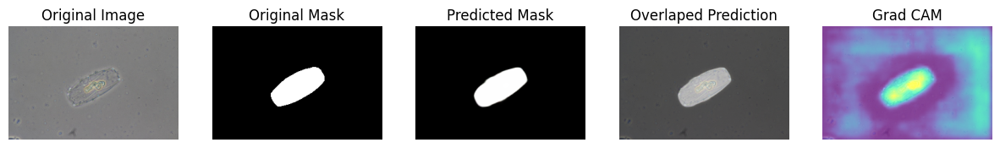

1/1 [==============================] - 0s 24ms/step


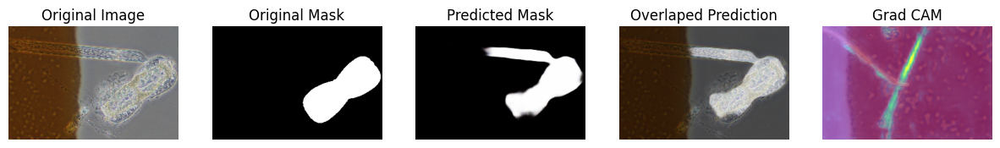

1/1 [==============================] - 0s 23ms/step


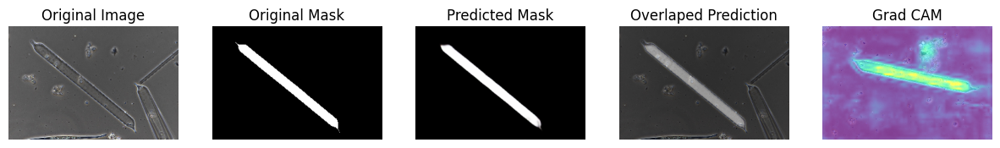

1/1 [==============================] - 0s 23ms/step


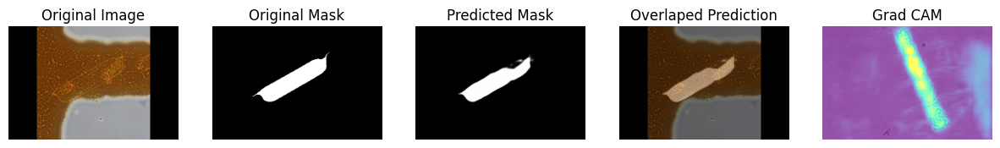

1/1 [==============================] - 0s 23ms/step


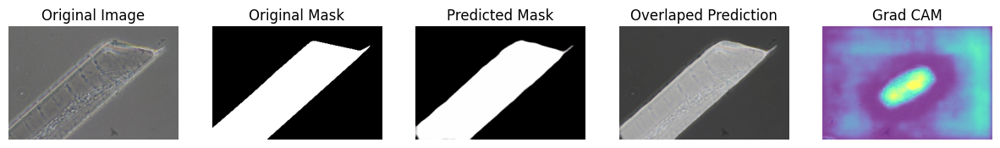

57/57 [==============================] - 12s 218ms/step - loss: 0.0092 - binary_io_u: 0.9489 - val_loss: 0.0402 - val_binary_io_u: 0.9285


In [23]:
optimizer = tfk.optimizers.Adam(learning_rate=1e-3)

model.compile(
    loss='binary_crossentropy',
    metrics=[tfk.metrics.BinaryIoU(threshold=0.5, name=None, dtype=None, target_class_ids=(0, 1))],
    optimizer=optimizer
)

class ShowProgress(Callback):
    def on_epoch_end(self, epoch, logs=None):
        if (epoch+1)%5==0:
            show_images(valid_ds, model=self.model, explain=True, n_images=5, SIZE=(15, 8))

callbacks = [
    ModelCheckpoint("DeepLabV3-Plus.keras"), 
    ShowProgress(),
]

history = model.fit(train_ds, validation_data=valid_ds, epochs=50, callbacks=callbacks)

## **DeepLab Model Evaluation**

In [24]:
score = model.evaluate(test_ds)
print("Loss: ", score[0])
print("IoU: ", score[1])

2/2 [==============================] - 0s 53ms/step - loss: 0.0242 - binary_io_u: 0.9387
Loss:  0.024208925664424896
IoU:  0.9387439489364624


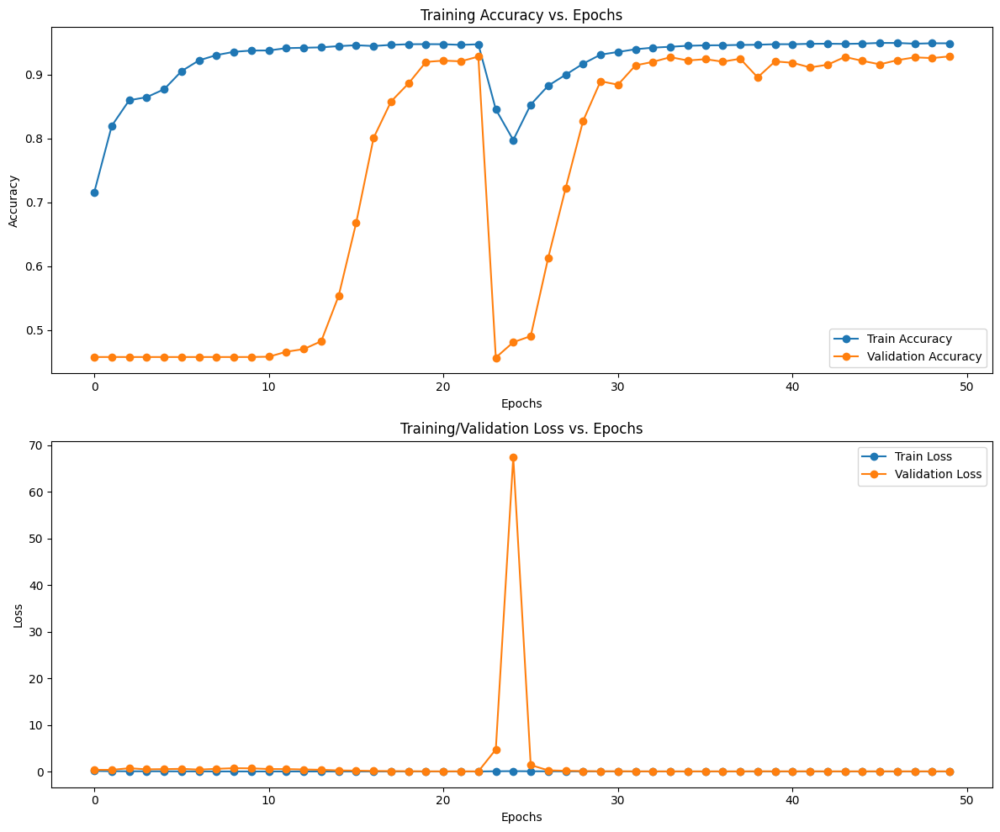

In [25]:
train_accuracy = history.history['binary_io_u']
val_accuracy = history.history['val_binary_io_u']
train_loss = history.history['loss']
val_loss = history.history['val_loss']

fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(12, 10))

ax[0].set_title('Training Accuracy vs. Epochs')
ax[0].plot(train_accuracy, 'o-', label='Train Accuracy')
ax[0].plot(val_accuracy, 'o-', label='Validation Accuracy')
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('Accuracy')
ax[0].legend(loc='best')

ax[1].set_title('Training/Validation Loss vs. Epochs')
ax[1].plot(train_loss, 'o-', label='Train Loss')
ax[1].plot(val_loss, 'o-', label='Validation Loss')
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Loss')
ax[1].legend(loc='best')

plt.tight_layout()
plt.show()

In [31]:
model.save('DeepLabV3-Plus')

1/1 [==============================] - 0s 27ms/step


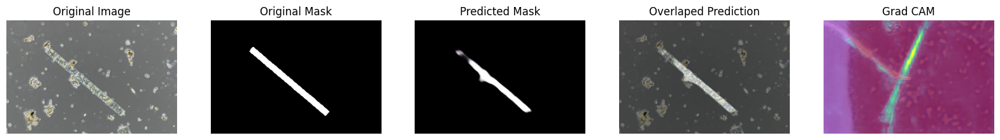

1/1 [==============================] - 0s 26ms/step


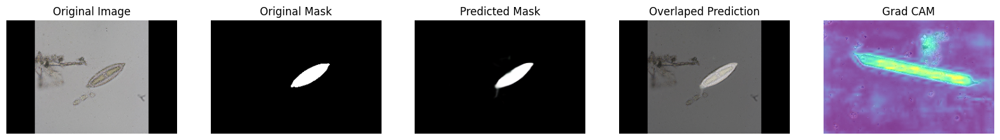

1/1 [==============================] - 0s 28ms/step


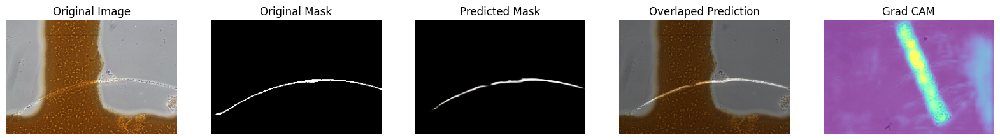

1/1 [==============================] - 0s 26ms/step


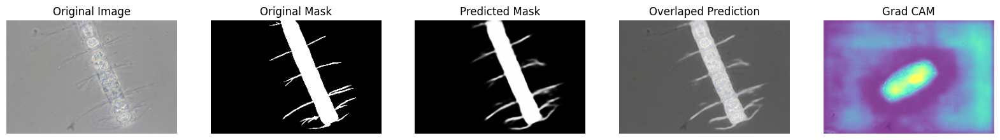

1/1 [==============================] - 0s 26ms/step


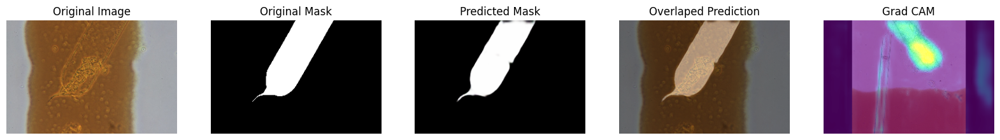

1/1 [==============================] - 0s 25ms/step


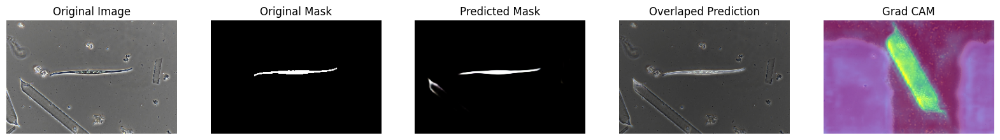

1/1 [==============================] - 0s 25ms/step


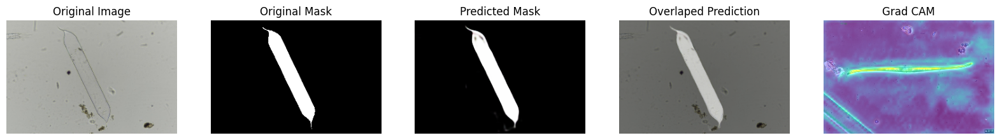

1/1 [==============================] - 0s 24ms/step


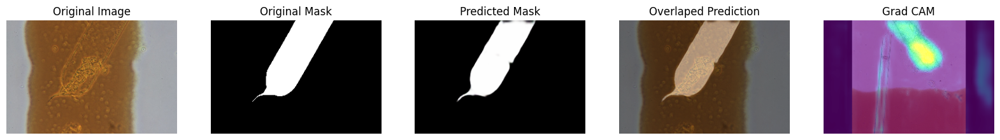

1/1 [==============================] - 0s 24ms/step


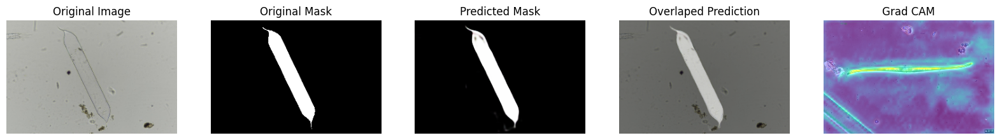

1/1 [==============================] - 0s 24ms/step


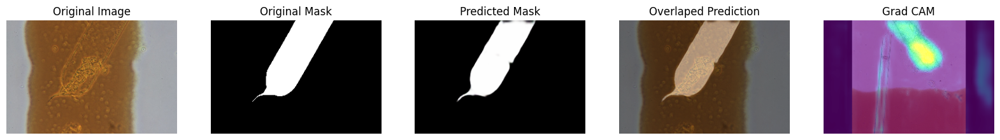

In [27]:
show_images(test_ds, model=model, explain=True, n_images=10, SIZE=(20, 8))

## **DeepLab Test Model**

In [33]:
!tar -zcvf DeepLabV3-Plus.tar.gz /kaggle/working/DeepLabV3-Plus

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


tar: Removing leading `/' from member names
/kaggle/working/DeepLabV3-Plus/
/kaggle/working/DeepLabV3-Plus/assets/
/kaggle/working/DeepLabV3-Plus/variables/
/kaggle/working/DeepLabV3-Plus/variables/variables.index
/kaggle/working/DeepLabV3-Plus/variables/variables.data-00000-of-00001
/kaggle/working/DeepLabV3-Plus/saved_model.pb
/kaggle/working/DeepLabV3-Plus/keras_metadata.pb
/kaggle/working/DeepLabV3-Plus/fingerprint.pb


1/1 [==============================] - 8s 8s/step


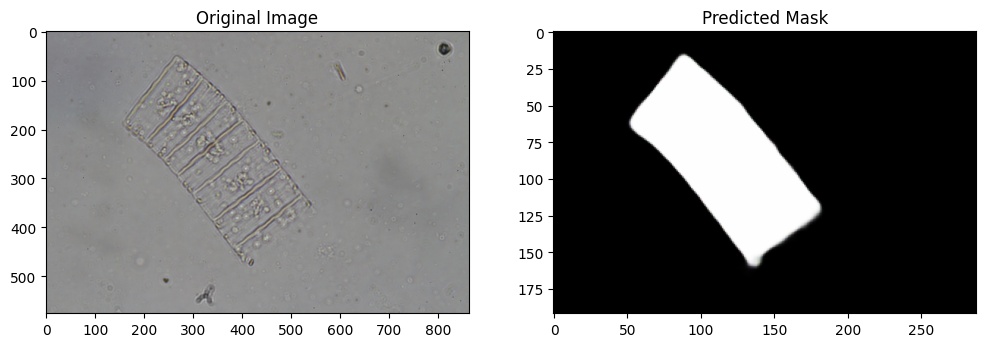

In [67]:
def load_image_for_prediction(path, IMAGE_SIZE=(192, 288)):
    image = load_img(path)
    image = img_to_array(image)
    image = tfi.resize(image, IMAGE_SIZE)
    image = tf.cast(image, tf.float32)
    image = image / 255.0
    return image

def predict_mask(model, image_path, IMAGE_SIZE=(192, 288)):
    image = load_image_for_prediction(image_path, IMAGE_SIZE=IMAGE_SIZE)
    predicted_mask = model.predict(image[np.newaxis, ...])[0]
    return predicted_mask

def visualize_prediction(image_path, predicted_mask):
    original_image = load_img(image_path)
    
    plt.figure(figsize=(12, 5))
    
    plt.subplot(1, 2, 1)
    plt.imshow(original_image)
    plt.title("Original Image")
    
    plt.subplot(1, 2, 2)
    plt.imshow(predicted_mask, cmap='gray')
    plt.title("Predicted Mask")
    
    plt.show()

l_model = tfk.models.load_model('/kaggle/working/DeepLabV3-Plus')
img_path = "/kaggle/input/image-and-mask-pythoplankton-dataset/segmentation/image/Achnanthes sp 1_blur.jpg"
predicted_mask = predict_mask(l_model, img_path)
visualize_prediction(img_path, predicted_mask)

# **SegNet**

In [33]:
def ConvBlock(block_input, name, num_filters=256, kernel_size=3, dilation_rate=1, use_bias=False):
    x = Conv2D(
        num_filters,
        kernel_size=kernel_size,
        dilation_rate=dilation_rate,
        padding="same",
        use_bias=use_bias,
        kernel_initializer='he_normal'
    )(block_input)
    x = BatchNormalization()(x)
    x = ReLU(name=name)(x)
    return x

In [58]:
def SegNet(IMAGE_SIZE_1=192, IMAGE_SIZE_2=288):
    tfk.backend.clear_session()
    
    # Input
    InputL = Input(shape=(IMAGE_SIZE_1, IMAGE_SIZE_2, 3))
    
    # Encoder
    conv_1_1 = ConvBlock(InputL, 'Conv1_1', 32, 3)
    conv_1_2 = ConvBlock(conv_1_1, 'Conv1_2', 32, 3)
    pool_1   = MaxPooling2D(2)(conv_1_2)
    
    conv_2_1 = ConvBlock(pool_1, 'Conv2_1', 64, 3)
    conv_2_2 = ConvBlock(conv_2_1, 'Conv2_2', 64, 3)
    pool_2   = MaxPooling2D(2)(conv_2_2)
    
    conv_3_1 = ConvBlock(pool_2, 'Conv3_1', 128, 3)
    conv_3_2 = ConvBlock(conv_3_1, 'Conv3_2', 128, 3)
    pool_3   = MaxPooling2D(2)(conv_3_2)
    
    conv_4_1 = ConvBlock(pool_3, 'Conv4_1', 256, 3)
    conv_4_2 = ConvBlock(conv_4_1, 'Conv4_2', 256, 3)
    pool_4   = MaxPooling2D(2)(conv_4_2)
    
    conv_5_1 = ConvBlock(pool_4, 'Conv5_1', 512, 3)
    conv_5_2 = ConvBlock(conv_5_1, 'Conv5_2', 512, 3)
    pool_5   = MaxPooling2D(2)(conv_5_2)
    
    # Decoder
    up_5        = UpSampling2D(2, interpolation='bilinear')(pool_5)
    conv_up_5_1 = ConvBlock(up_5, 'Top-ConvBlock-2', 512, 3)
    conv_up_5_2 = ConvBlock(conv_up_5_1, 'ConvUp5_2', 512, 3)
    
    up_4        = UpSampling2D(2, interpolation='bilinear')(conv_up_5_2)
    conv_up_4_1 = ConvBlock(up_4, 'ConvUp4_1', 256, 3)
    conv_up_4_2 = ConvBlock(conv_up_4_1, 'ConvUp4_2', 256, 3)
    
    up_3        = UpSampling2D(2, interpolation='bilinear')(conv_up_4_2)
    conv_up_3_1 = ConvBlock(up_3, 'ConvUp3_1', 128, 3)
    conv_up_3_2 = ConvBlock(conv_up_3_1, 'ConvUp3_2', 128, 3)
    
    up_2        = UpSampling2D(2, interpolation='bilinear')(conv_up_3_2)
    conv_up_2_1 = ConvBlock(up_2, 'ConvUp2_1', 64, 3)
    conv_up_2_2 = ConvBlock(conv_up_2_1, 'ConvUp2_2', 64, 3)
    
    up_1        = UpSampling2D(2, interpolation='bilinear')(conv_up_2_2)
    conv_up_1_1 = ConvBlock(up_1, 'Top-ConvBlock-1', 32, 3)
    conv_up_1_2 = ConvBlock(conv_up_1_1, 'ConvUp1_2', 32, 3)
    
    # Output
    PredMask = Conv2D(3, kernel_size=3, strides=1, padding='same', activation='sigmoid', use_bias=False, name="OutputMask")(conv_up_1_2)
    model = Model(InputL, PredMask, name="SegNet")
    return model

model = SegNet()

In [ ]:
plot_model(model, "SegNet.png", show_shapes=True, dpi=96)

## **SegNet Model Training**

Epoch 1/50
57/57 [==============================] - 24s 165ms/step - loss: 0.2672 - binary_io_u: 0.5826 - val_loss: 0.6951 - val_binary_io_u: 0.5276
Epoch 2/50
57/57 [==============================] - 7s 112ms/step - loss: 0.1374 - binary_io_u: 0.7051 - val_loss: 0.6170 - val_binary_io_u: 0.4853
Epoch 3/50
57/57 [==============================] - 6s 112ms/step - loss: 0.1143 - binary_io_u: 0.7446 - val_loss: 0.4699 - val_binary_io_u: 0.5416
Epoch 4/50
57/57 [==============================] - 7s 113ms/step - loss: 0.1033 - binary_io_u: 0.7622 - val_loss: 0.2787 - val_binary_io_u: 0.6410
Epoch 5/50
1/1 [==============================] - 3s 3s/step- loss: 0.0941 - binary_io_u: 0.78


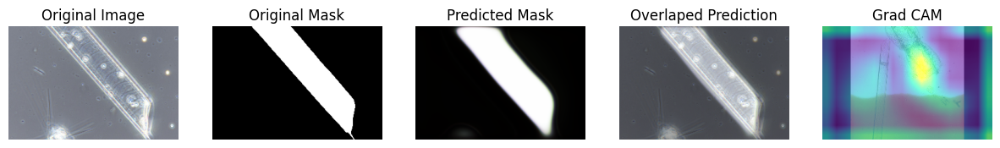

1/1 [==============================] - 0s 50ms/step


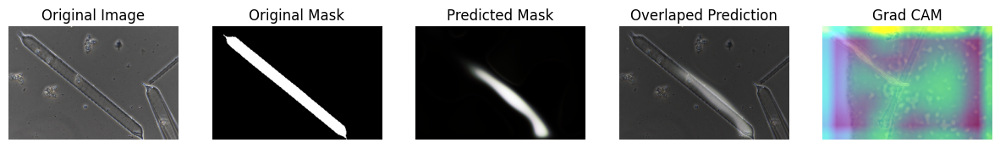

1/1 [==============================] - 0s 21ms/step


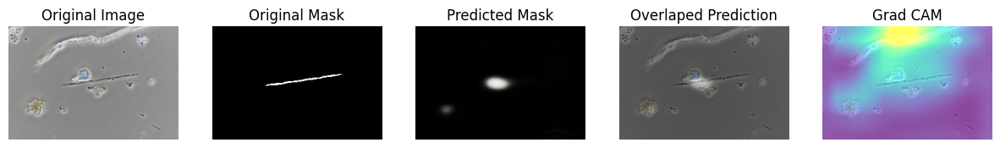

1/1 [==============================] - 0s 20ms/step


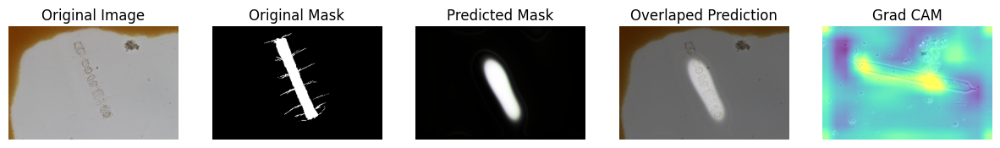

1/1 [==============================] - 0s 20ms/step


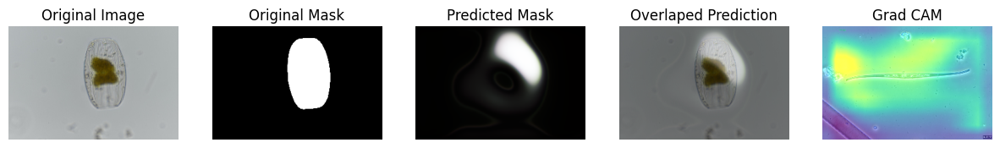

57/57 [==============================] - 13s 228ms/step - loss: 0.0941 - binary_io_u: 0.7819 - val_loss: 0.2159 - val_binary_io_u: 0.7088
Epoch 6/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0854 - binary_io_u: 0.7995 - val_loss: 0.2069 - val_binary_io_u: 0.7171
Epoch 7/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0943 - binary_io_u: 0.7846 - val_loss: 0.1536 - val_binary_io_u: 0.7489
Epoch 8/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0850 - binary_io_u: 0.8021 - val_loss: 0.1716 - val_binary_io_u: 0.7512
Epoch 9/50
57/57 [==============================] - 7s 113ms/step - loss: 0.0755 - binary_io_u: 0.8230 - val_loss: 0.1096 - val_binary_io_u: 0.7973
Epoch 10/50
1/1 [==============================] - 0s 20ms/steploss: 0.0679 - binary_io_u: 0.83


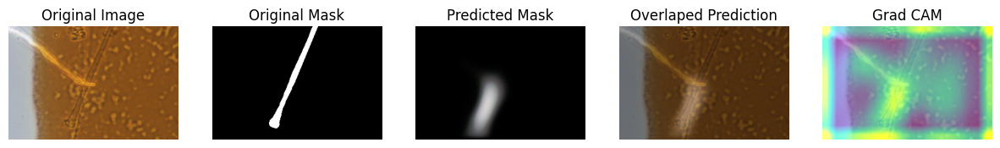

1/1 [==============================] - 0s 20ms/step


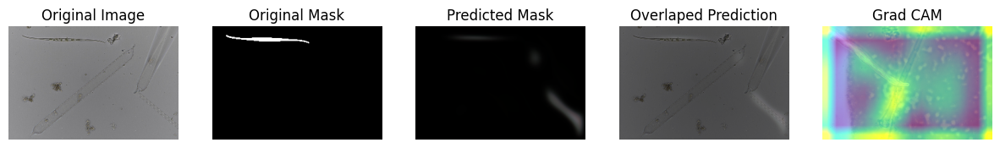

1/1 [==============================] - 0s 20ms/step


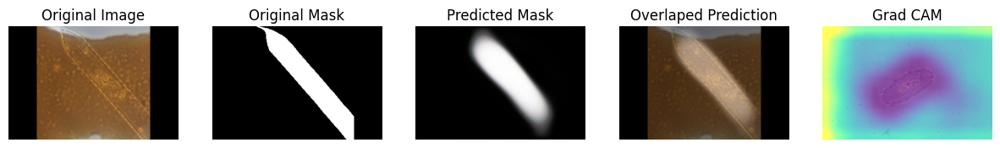

1/1 [==============================] - 0s 25ms/step


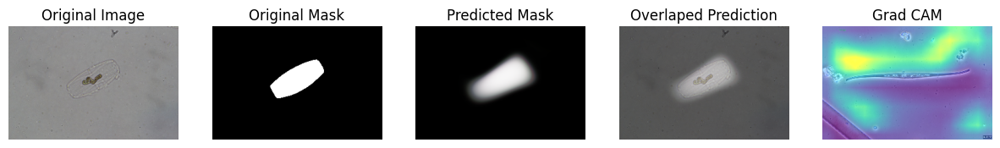

1/1 [==============================] - 0s 19ms/step


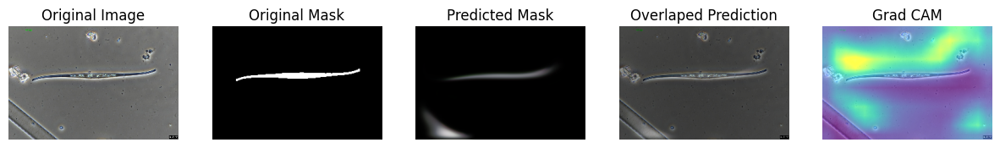

57/57 [==============================] - 10s 168ms/step - loss: 0.0679 - binary_io_u: 0.8369 - val_loss: 0.1045 - val_binary_io_u: 0.7987
Epoch 11/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0706 - binary_io_u: 0.8348 - val_loss: 0.1340 - val_binary_io_u: 0.7745
Epoch 12/50
57/57 [==============================] - 7s 113ms/step - loss: 0.0594 - binary_io_u: 0.8632 - val_loss: 0.0737 - val_binary_io_u: 0.8487
Epoch 13/50
57/57 [==============================] - 7s 113ms/step - loss: 0.0571 - binary_io_u: 0.8667 - val_loss: 0.0868 - val_binary_io_u: 0.8348
Epoch 14/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0570 - binary_io_u: 0.8672 - val_loss: 0.0783 - val_binary_io_u: 0.8450
Epoch 15/50
1/1 [==============================] - 0s 20ms/steploss: 0.0541 - binary_io_u: 0.87


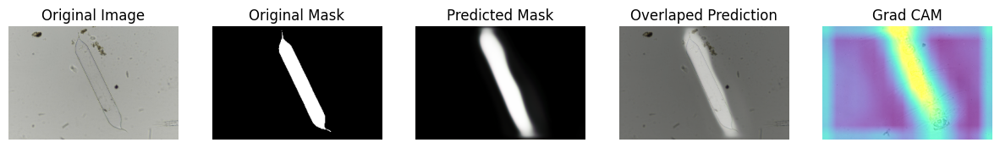

1/1 [==============================] - 0s 19ms/step


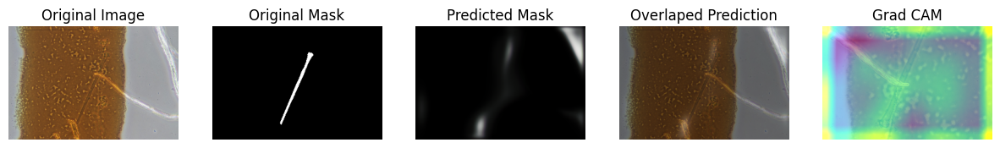

1/1 [==============================] - 0s 20ms/step


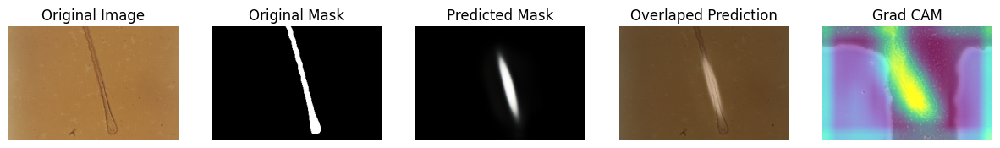

1/1 [==============================] - 0s 20ms/step


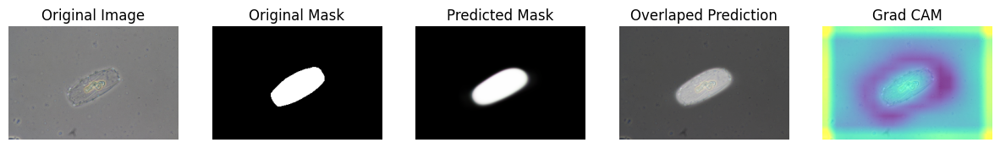

1/1 [==============================] - 0s 20ms/step


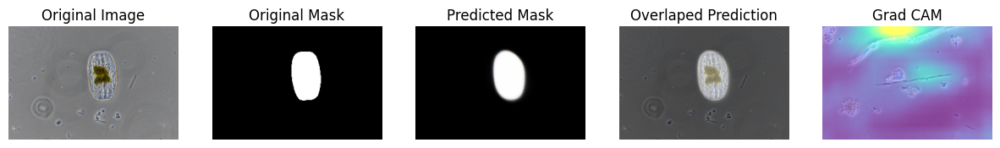

57/57 [==============================] - 10s 170ms/step - loss: 0.0541 - binary_io_u: 0.8726 - val_loss: 0.0718 - val_binary_io_u: 0.8634
Epoch 16/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0492 - binary_io_u: 0.8852 - val_loss: 0.0873 - val_binary_io_u: 0.8187
Epoch 17/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0432 - binary_io_u: 0.8971 - val_loss: 0.0757 - val_binary_io_u: 0.8516
Epoch 18/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0402 - binary_io_u: 0.9023 - val_loss: 0.0652 - val_binary_io_u: 0.8712
Epoch 19/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0409 - binary_io_u: 0.9011 - val_loss: 0.0533 - val_binary_io_u: 0.8907
Epoch 20/50
1/1 [==============================] - 0s 21ms/steploss: 0.0361 - binary_io_u: 0.91


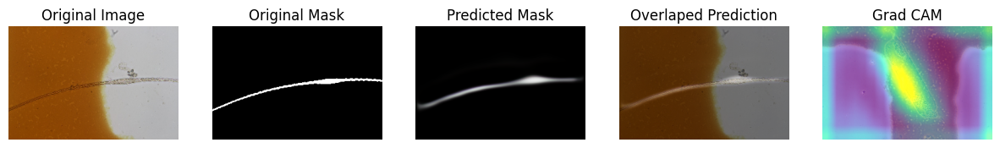

1/1 [==============================] - 0s 20ms/step


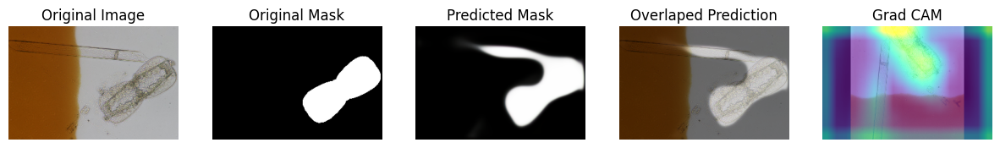

1/1 [==============================] - 0s 20ms/step


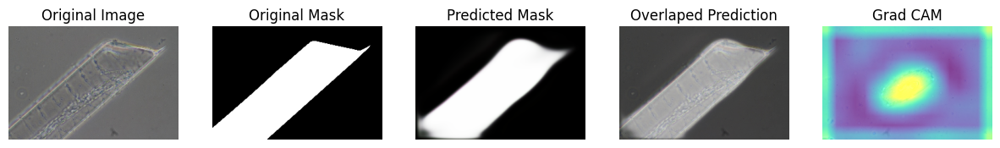

1/1 [==============================] - 0s 20ms/step


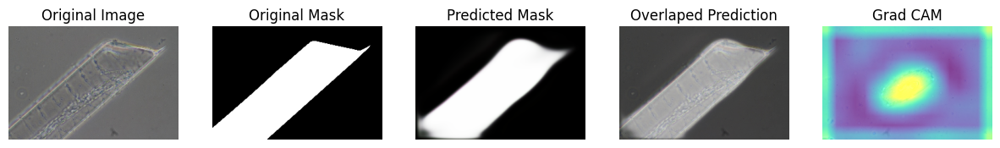

1/1 [==============================] - 0s 20ms/step


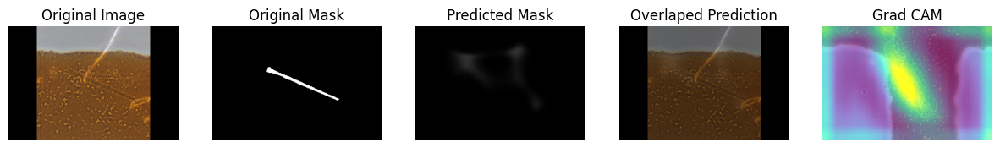

57/57 [==============================] - 10s 167ms/step - loss: 0.0361 - binary_io_u: 0.9103 - val_loss: 0.0579 - val_binary_io_u: 0.8805
Epoch 21/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0407 - binary_io_u: 0.9000 - val_loss: 0.1251 - val_binary_io_u: 0.8477
Epoch 22/50
57/57 [==============================] - 7s 111ms/step - loss: 0.0887 - binary_io_u: 0.7999 - val_loss: 0.4825 - val_binary_io_u: 0.5793
Epoch 23/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0646 - binary_io_u: 0.8475 - val_loss: 0.1377 - val_binary_io_u: 0.7993
Epoch 24/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0473 - binary_io_u: 0.8893 - val_loss: 0.0597 - val_binary_io_u: 0.8789
Epoch 25/50
1/1 [==============================] - 0s 19ms/steploss: 0.0395 - binary_io_u: 0.90


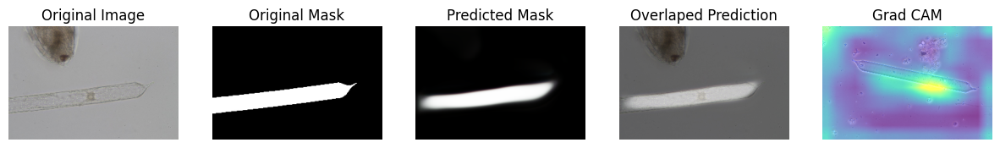

1/1 [==============================] - 0s 20ms/step


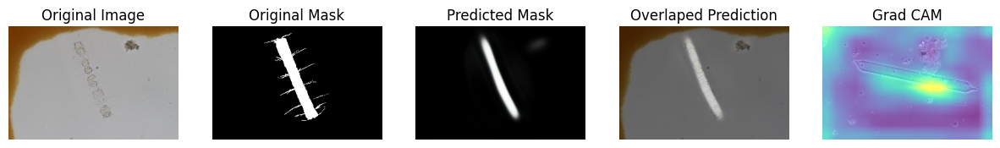

1/1 [==============================] - 0s 21ms/step


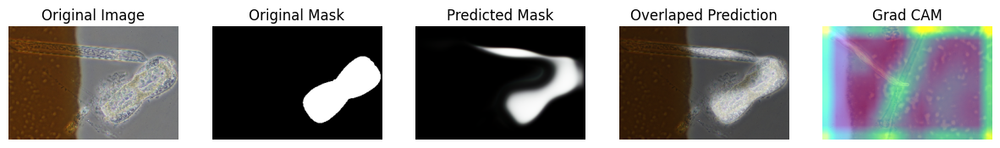

1/1 [==============================] - 0s 21ms/step


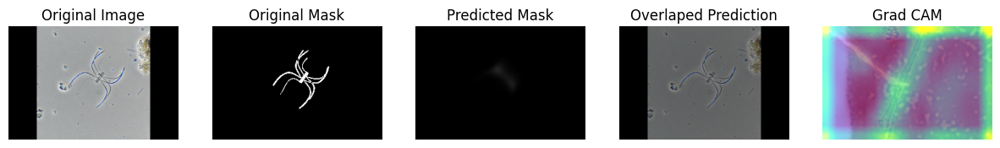

1/1 [==============================] - 0s 21ms/step


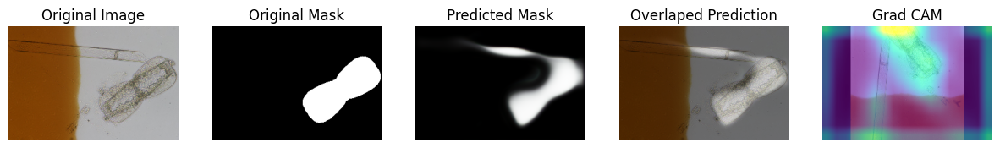

57/57 [==============================] - 11s 185ms/step - loss: 0.0395 - binary_io_u: 0.9052 - val_loss: 0.0625 - val_binary_io_u: 0.8654
Epoch 26/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0345 - binary_io_u: 0.9147 - val_loss: 0.0525 - val_binary_io_u: 0.8908
Epoch 27/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0316 - binary_io_u: 0.9202 - val_loss: 0.0604 - val_binary_io_u: 0.8656
Epoch 28/50
57/57 [==============================] - 7s 113ms/step - loss: 0.0312 - binary_io_u: 0.9191 - val_loss: 0.0494 - val_binary_io_u: 0.8939
Epoch 29/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0314 - binary_io_u: 0.9190 - val_loss: 0.0441 - val_binary_io_u: 0.9006
Epoch 30/50
1/1 [==============================] - 0s 20ms/steploss: 0.0289 - binary_io_u: 0.92


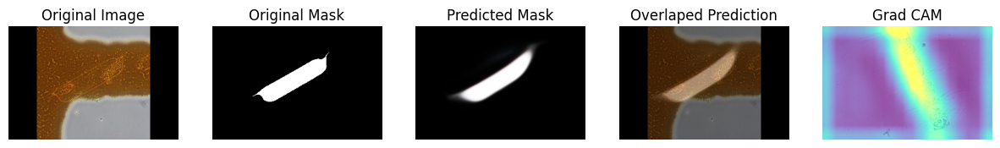

1/1 [==============================] - 0s 30ms/step


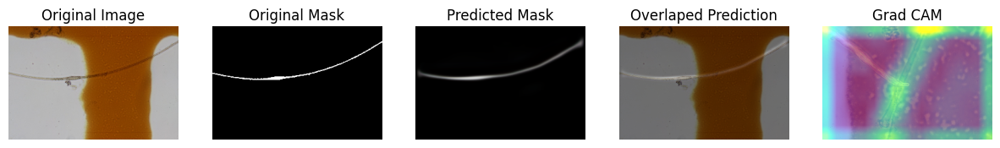

1/1 [==============================] - 0s 20ms/step


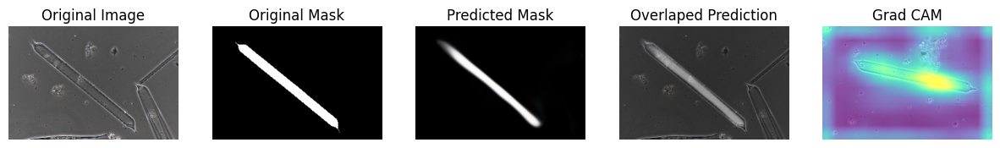

1/1 [==============================] - 0s 20ms/step


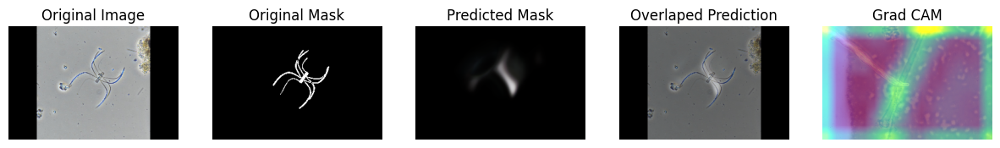

1/1 [==============================] - 0s 20ms/step


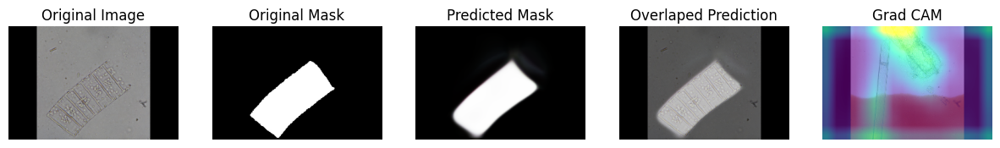

57/57 [==============================] - 10s 170ms/step - loss: 0.0289 - binary_io_u: 0.9225 - val_loss: 0.0446 - val_binary_io_u: 0.8998
Epoch 31/50
57/57 [==============================] - 7s 113ms/step - loss: 0.0275 - binary_io_u: 0.9248 - val_loss: 0.0644 - val_binary_io_u: 0.8807
Epoch 32/50
57/57 [==============================] - 7s 113ms/step - loss: 0.0281 - binary_io_u: 0.9252 - val_loss: 0.0521 - val_binary_io_u: 0.8995
Epoch 33/50
57/57 [==============================] - 7s 113ms/step - loss: 0.0273 - binary_io_u: 0.9265 - val_loss: 0.0519 - val_binary_io_u: 0.8897
Epoch 34/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0296 - binary_io_u: 0.9218 - val_loss: 0.0452 - val_binary_io_u: 0.9034
Epoch 35/50
1/1 [==============================] - 0s 20ms/steploss: 0.0262 - binary_io_u: 0.92


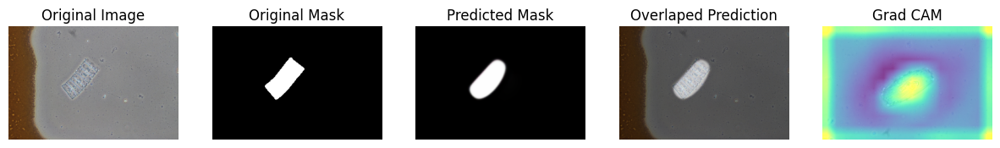

1/1 [==============================] - 0s 51ms/step


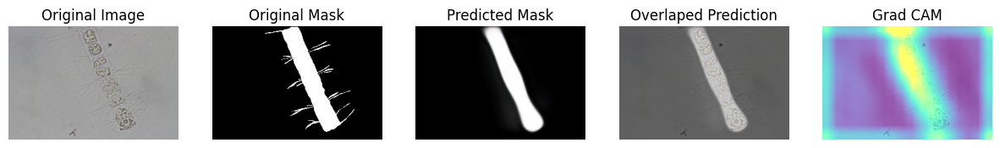

1/1 [==============================] - 0s 21ms/step


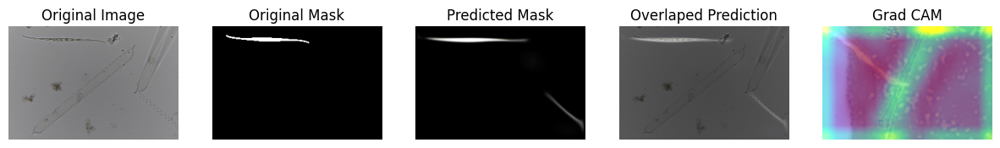

1/1 [==============================] - 0s 19ms/step


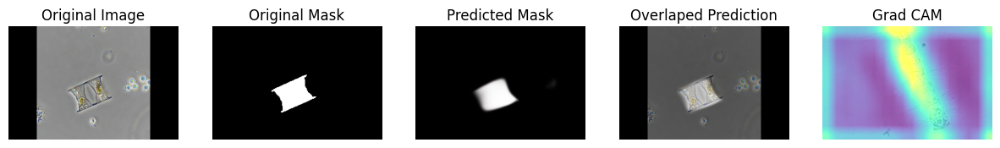

1/1 [==============================] - 0s 19ms/step


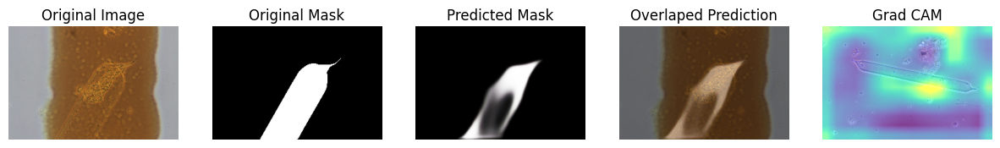

57/57 [==============================] - 9s 165ms/step - loss: 0.0262 - binary_io_u: 0.9271 - val_loss: 0.0511 - val_binary_io_u: 0.8957
Epoch 36/50
57/57 [==============================] - 7s 113ms/step - loss: 0.0262 - binary_io_u: 0.9273 - val_loss: 0.0458 - val_binary_io_u: 0.9026
Epoch 37/50
57/57 [==============================] - 7s 113ms/step - loss: 0.0245 - binary_io_u: 0.9309 - val_loss: 0.0488 - val_binary_io_u: 0.8930
Epoch 38/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0247 - binary_io_u: 0.9295 - val_loss: 0.0609 - val_binary_io_u: 0.8924
Epoch 39/50
57/57 [==============================] - 7s 113ms/step - loss: 0.0243 - binary_io_u: 0.9305 - val_loss: 0.0486 - val_binary_io_u: 0.9042
Epoch 40/50
1/1 [==============================] - 0s 19ms/steploss: 0.0249 - binary_io_u: 0.92


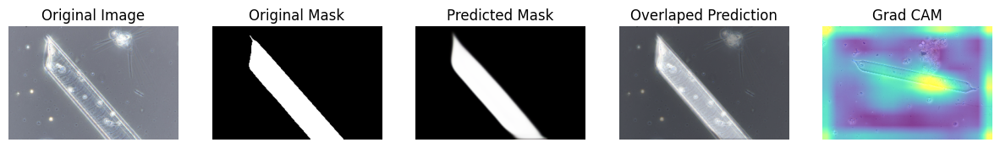

1/1 [==============================] - 0s 19ms/step


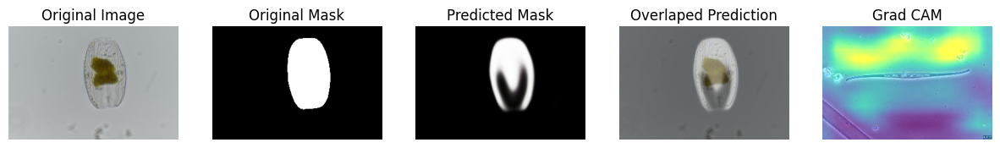

1/1 [==============================] - 0s 19ms/step


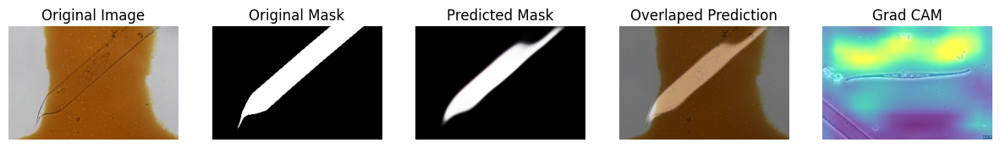

1/1 [==============================] - 0s 20ms/step


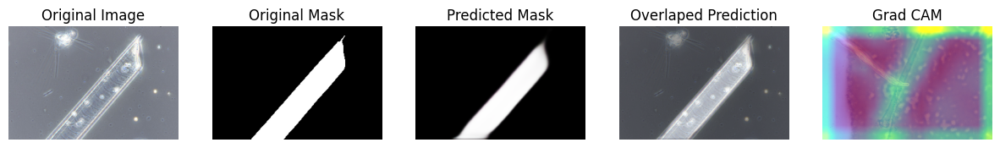

1/1 [==============================] - 0s 20ms/step


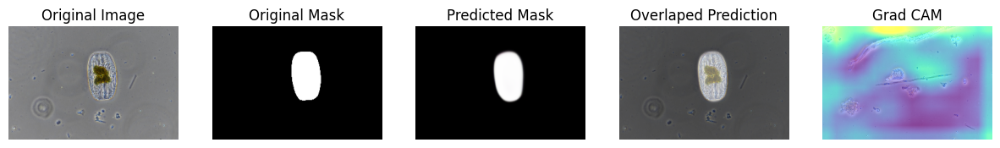

57/57 [==============================] - 10s 170ms/step - loss: 0.0249 - binary_io_u: 0.9292 - val_loss: 0.0522 - val_binary_io_u: 0.8928
Epoch 41/50
57/57 [==============================] - 7s 113ms/step - loss: 0.0247 - binary_io_u: 0.9291 - val_loss: 0.0713 - val_binary_io_u: 0.8631
Epoch 42/50
57/57 [==============================] - 7s 113ms/step - loss: 0.0239 - binary_io_u: 0.9317 - val_loss: 0.0504 - val_binary_io_u: 0.9108
Epoch 43/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0202 - binary_io_u: 0.9381 - val_loss: 0.0436 - val_binary_io_u: 0.9080
Epoch 44/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0207 - binary_io_u: 0.9362 - val_loss: 0.0467 - val_binary_io_u: 0.9137
Epoch 45/50
1/1 [==============================] - 0s 20ms/steploss: 0.0223 - binary_io_u: 0.93


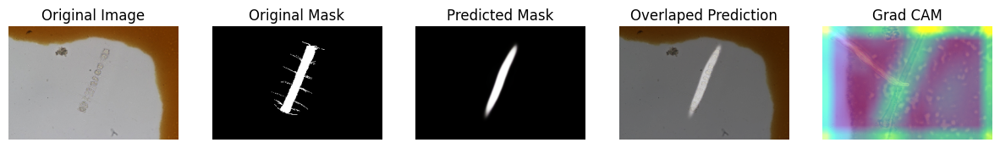

1/1 [==============================] - 0s 20ms/step


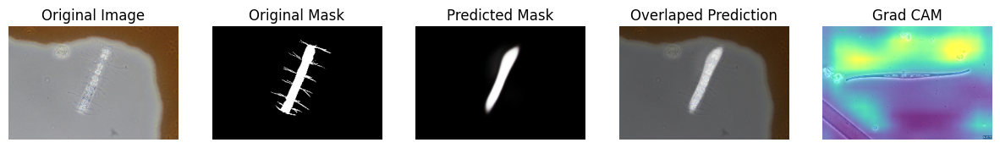

1/1 [==============================] - 0s 20ms/step


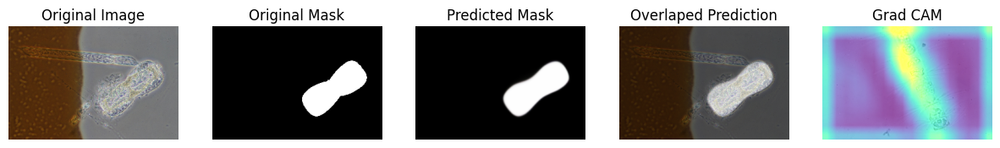

1/1 [==============================] - 0s 20ms/step


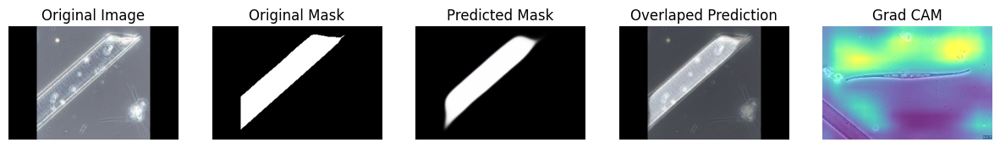

1/1 [==============================] - 0s 19ms/step


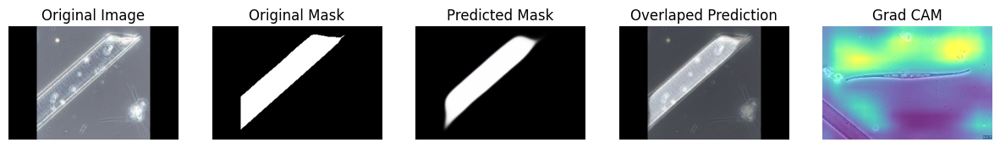

57/57 [==============================] - 9s 165ms/step - loss: 0.0223 - binary_io_u: 0.9333 - val_loss: 0.0507 - val_binary_io_u: 0.9089
Epoch 46/50
57/57 [==============================] - 7s 113ms/step - loss: 0.0236 - binary_io_u: 0.9310 - val_loss: 0.0591 - val_binary_io_u: 0.8915
Epoch 47/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0214 - binary_io_u: 0.9355 - val_loss: 0.0477 - val_binary_io_u: 0.9085
Epoch 48/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0217 - binary_io_u: 0.9344 - val_loss: 0.0528 - val_binary_io_u: 0.8969
Epoch 49/50
57/57 [==============================] - 7s 112ms/step - loss: 0.0216 - binary_io_u: 0.9355 - val_loss: 0.0424 - val_binary_io_u: 0.9115
Epoch 50/50
1/1 [==============================] - 0s 20ms/steploss: 0.0220 - binary_io_u: 0.93


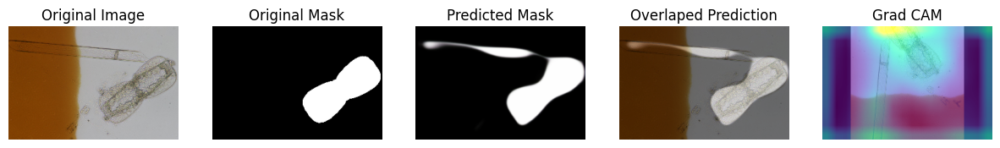

1/1 [==============================] - 0s 27ms/step


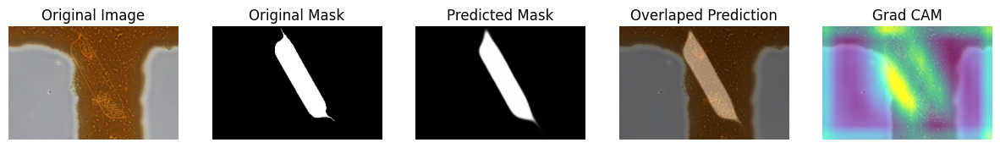

1/1 [==============================] - 0s 20ms/step


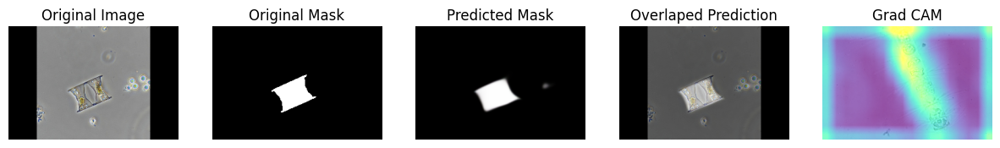

1/1 [==============================] - 0s 21ms/step


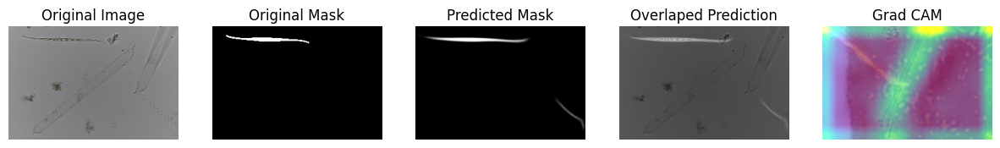

1/1 [==============================] - 0s 20ms/step


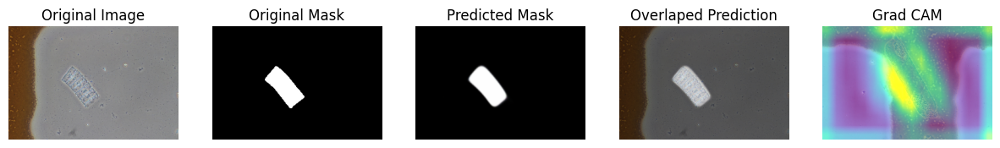

57/57 [==============================] - 10s 168ms/step - loss: 0.0220 - binary_io_u: 0.9333 - val_loss: 0.0441 - val_binary_io_u: 0.9113


In [59]:
optimizer = tfk.optimizers.Adam(learning_rate=1e-3)

model.compile(
    loss='binary_crossentropy',
    metrics=[tfk.metrics.BinaryIoU(threshold=0.5, name=None, dtype=None, target_class_ids=(0, 1))],
    optimizer=optimizer
)

class ShowProgress(Callback):
    def on_epoch_end(self, epoch, logs=None):
        if (epoch+1)%5==0:
            show_images(valid_ds, model=self.model, explain=True, n_images=5, SIZE=(15, 8))

callbacks = [
    ModelCheckpoint("SegNet.keras"), 
    ShowProgress(),
]

history = model.fit(train_ds, validation_data=valid_ds, epochs=50, callbacks=callbacks)

## **SegNet Model Evaluation**

In [60]:
score = model.evaluate(test_ds)
print("Loss: ", score[0])
print("IoU: ", score[1])

2/2 [==============================] - 0s 40ms/step - loss: 0.0584 - binary_io_u: 0.8836
Loss:  0.058384016156196594
IoU:  0.8835679292678833


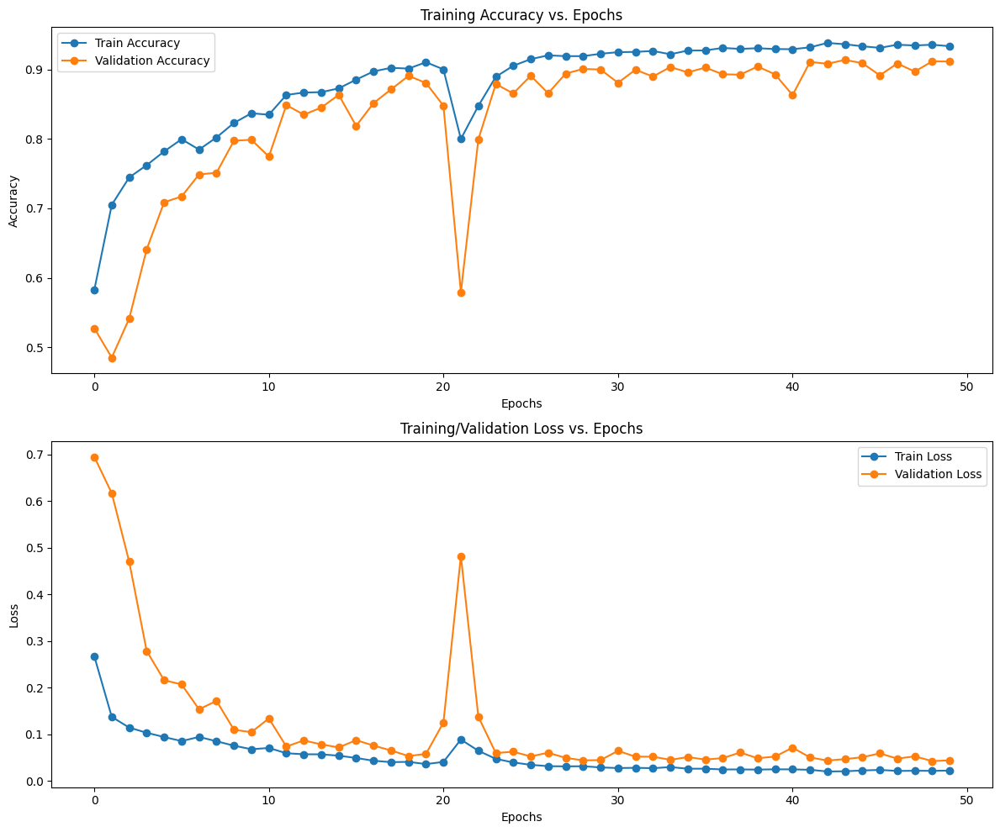

In [61]:
train_accuracy = history.history['binary_io_u']
val_accuracy = history.history['val_binary_io_u']
train_loss = history.history['loss']
val_loss = history.history['val_loss']

fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(12, 10))

ax[0].set_title('Training Accuracy vs. Epochs')
ax[0].plot(train_accuracy, 'o-', label='Train Accuracy')
ax[0].plot(val_accuracy, 'o-', label='Validation Accuracy')
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('Accuracy')
ax[0].legend(loc='best')

ax[1].set_title('Training/Validation Loss vs. Epochs')
ax[1].plot(train_loss, 'o-', label='Train Loss')
ax[1].plot(val_loss, 'o-', label='Validation Loss')
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Loss')
ax[1].legend(loc='best')

plt.tight_layout()
plt.show()

In [62]:
model.save('SegNet')

1/1 [==============================] - 2s 2s/step


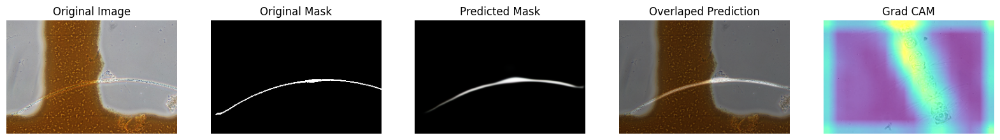

1/1 [==============================] - 0s 21ms/step


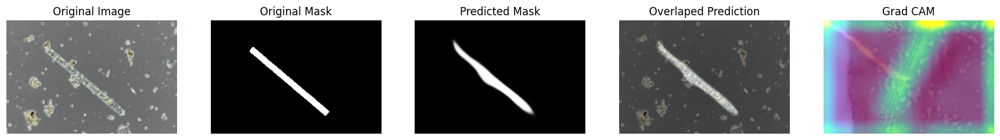

1/1 [==============================] - 0s 20ms/step


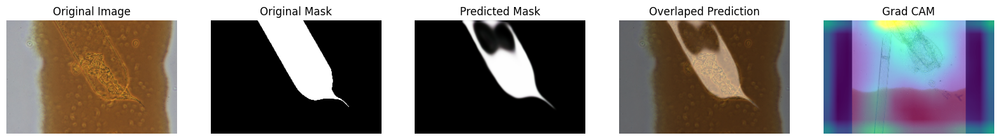

1/1 [==============================] - 0s 20ms/step


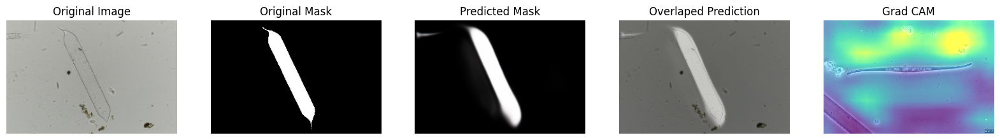

1/1 [==============================] - 0s 20ms/step


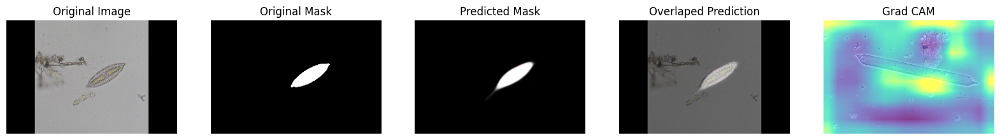

1/1 [==============================] - 0s 20ms/step


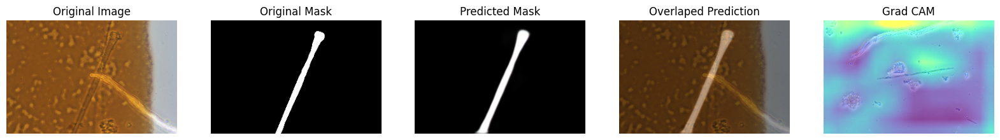

1/1 [==============================] - 0s 20ms/step


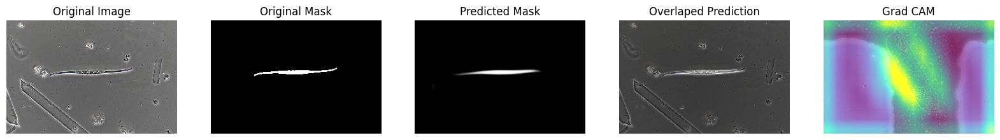

1/1 [==============================] - 0s 20ms/step


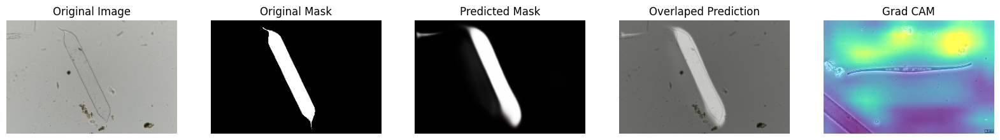

1/1 [==============================] - 0s 20ms/step


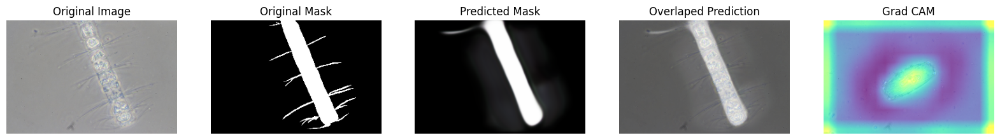

1/1 [==============================] - 0s 20ms/step


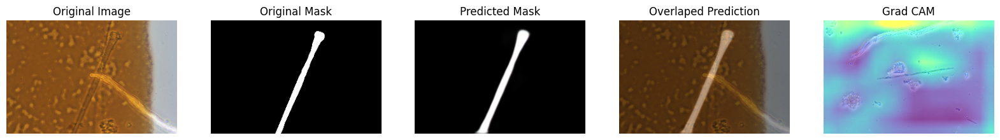

In [70]:
show_images(test_ds, model=model, explain=True, n_images=10, SIZE=(20, 8))

## **SegNet Test Model**

In [65]:
!tar -zcvf SegNet.tar.gz /kaggle/working/SegNet

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


tar: Removing leading `/' from member names
/kaggle/working/SegNet/
/kaggle/working/SegNet/saved_model.pb
/kaggle/working/SegNet/variables/
/kaggle/working/SegNet/variables/variables.data-00000-of-00001
/kaggle/working/SegNet/variables/variables.index
/kaggle/working/SegNet/keras_metadata.pb
/kaggle/working/SegNet/fingerprint.pb
/kaggle/working/SegNet/assets/


1/1 [==============================] - 3s 3s/step


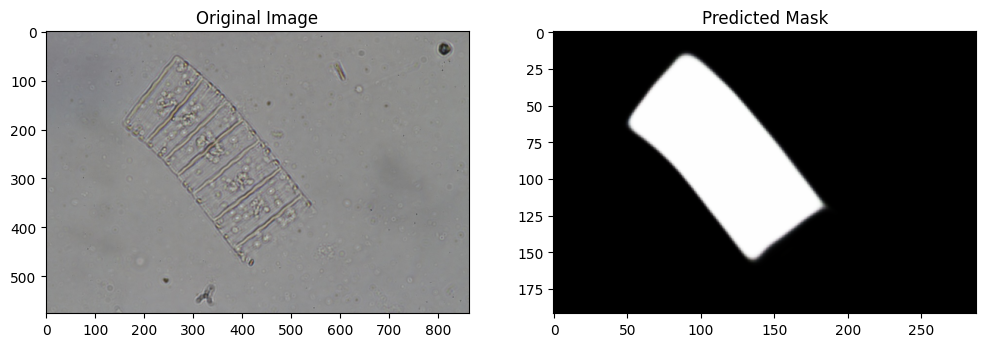

In [69]:
def load_image_for_prediction(path, IMAGE_SIZE=(192, 288)):
    image = load_img(path)
    image = img_to_array(image)
    image = tfi.resize(image, IMAGE_SIZE)
    image = tf.cast(image, tf.float32)
    image = image / 255.0
    return image

def predict_mask(model, image_path, IMAGE_SIZE=(192, 288)):
    image = load_image_for_prediction(image_path, IMAGE_SIZE=IMAGE_SIZE)
    predicted_mask = model.predict(image[np.newaxis, ...])[0]
    return predicted_mask

def visualize_prediction(image_path, predicted_mask):
    original_image = load_img(image_path)
    
    plt.figure(figsize=(12, 5))
    
    plt.subplot(1, 2, 1)
    plt.imshow(original_image)
    plt.title("Original Image")
    
    plt.subplot(1, 2, 2)
    plt.imshow(predicted_mask, cmap='gray')
    plt.title("Predicted Mask")
    
    plt.show()

l_model = tfk.models.load_model('/kaggle/working/SegNet')
img_path = "/kaggle/input/image-and-mask-pythoplankton-dataset/segmentation/image/Achnanthes sp 1_blur.jpg"
predicted_mask = predict_mask(l_model, img_path)
visualize_prediction(img_path, predicted_mask)

# **U-Net**

In [50]:
def ConvBlock(inputs, name, num_filters=256, kernel_size=3, dilation_rate=1, use_bias=False):
    x = Conv2D(
        num_filters,
        kernel_size=kernel_size,
        dilation_rate=dilation_rate,
        padding="same",
        use_bias=use_bias,
        kernel_initializer='he_normal'
    )(inputs)
    x = BatchNormalization()(x)
    x = ReLU(name=name)(x)
    return x

def UpSampleBlock(next_prev, conv_prev, num_filters, name):
    up     = Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding="same")(next_prev)
    concat = Concatenate()([up, conv_prev])
    conv   = ConvBlock(concat, name, num_filters)
    return conv

In [51]:
def UNet(IMAGE_SIZE_1=192, IMAGE_SIZE_2=288):
    tfk.backend.clear_session()
    
    # Inputs
    InputL = Input((IMAGE_SIZE_1, IMAGE_SIZE_2, 3))

    # Contraction path
    c1 = ConvBlock(InputL, 'Top-ConvBlock-1', 32)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = ConvBlock(p1, 'ConvBlock_C2', 64)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = ConvBlock(p2, 'ConvBlock_C3', 128)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = ConvBlock(p3, 'ConvBlock_C4', 256)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = ConvBlock(p4, 'Top-ConvBlock-2', 512)

    # Expansive path
    c6 = UpSampleBlock(c5, c4, 128, name='UpSampleBlock_C4')
    c7 = UpSampleBlock(c6, c3, 64, name='UpSampleBlock_C3')
    c8 = UpSampleBlock(c7, c2, 32, name='UpSampleBlock_C2')
    c9 = UpSampleBlock(c8, c1, 16, name='UpSampleBlock_C1')

    # Output layer
    PredMask = Conv2D(3, kernel_size=3, strides=1, padding='same', activation='sigmoid', use_bias=False, name="OutputMask")(c9)
    model = Model(InputL, PredMask, name="U-Net")
    
    return model

model = UNet()

## **U-Net Model Training**

Epoch 1/50
57/57 [==============================] - 16s 86ms/step - loss: 0.2649 - binary_io_u: 0.5461 - val_loss: 0.6508 - val_binary_io_u: 0.4578
Epoch 2/50
57/57 [==============================] - 3s 54ms/step - loss: 0.1346 - binary_io_u: 0.7024 - val_loss: 0.3513 - val_binary_io_u: 0.4628
Epoch 3/50
57/57 [==============================] - 3s 53ms/step - loss: 0.1130 - binary_io_u: 0.7490 - val_loss: 0.4839 - val_binary_io_u: 0.4596
Epoch 4/50
57/57 [==============================] - 4s 56ms/step - loss: 0.0970 - binary_io_u: 0.7782 - val_loss: 0.3477 - val_binary_io_u: 0.5141
Epoch 5/50
1/1 [==============================] - 2s 2s/step- loss: 0.0881 - binary_io_u: 0.79


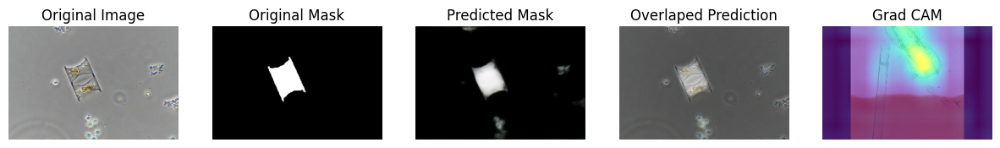

1/1 [==============================] - 0s 20ms/step


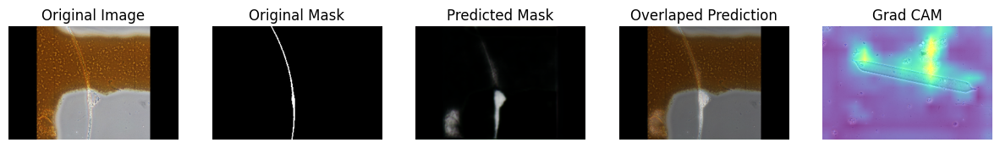

1/1 [==============================] - 0s 22ms/step


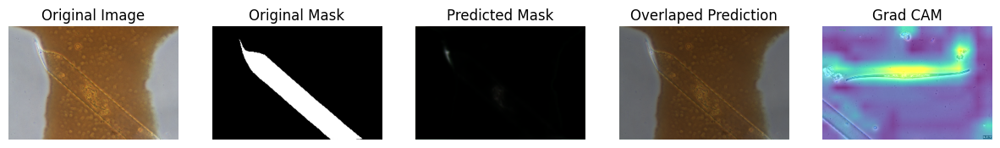

1/1 [==============================] - 0s 22ms/step


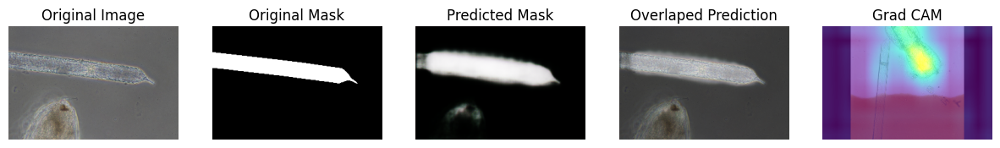

1/1 [==============================] - 0s 21ms/step


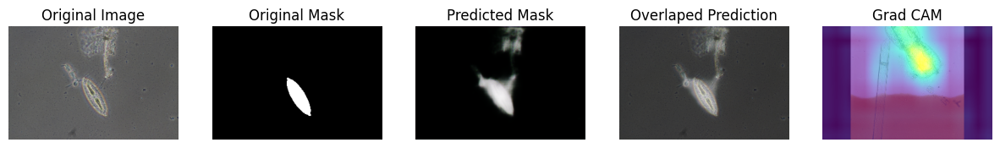

57/57 [==============================] - 10s 166ms/step - loss: 0.0881 - binary_io_u: 0.7907 - val_loss: 0.1975 - val_binary_io_u: 0.6976
Epoch 6/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0848 - binary_io_u: 0.7966 - val_loss: 0.2534 - val_binary_io_u: 0.6559
Epoch 7/50
57/57 [==============================] - 3s 54ms/step - loss: 0.0753 - binary_io_u: 0.8161 - val_loss: 0.3378 - val_binary_io_u: 0.6208
Epoch 8/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0731 - binary_io_u: 0.8238 - val_loss: 0.1619 - val_binary_io_u: 0.7527
Epoch 9/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0618 - binary_io_u: 0.8479 - val_loss: 0.1193 - val_binary_io_u: 0.7734
Epoch 10/50
1/1 [==============================] - 0s 21ms/steploss: 0.0553 - binary_io_u: 0.86


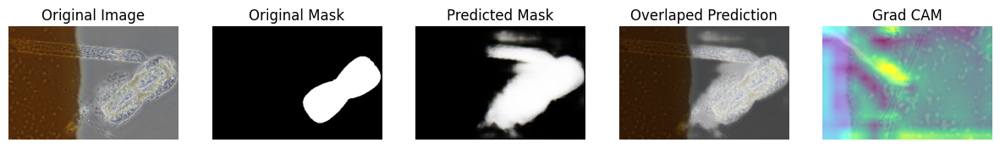

1/1 [==============================] - 0s 78ms/step


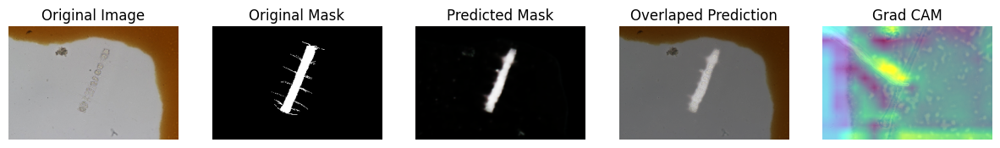

1/1 [==============================] - 0s 21ms/step


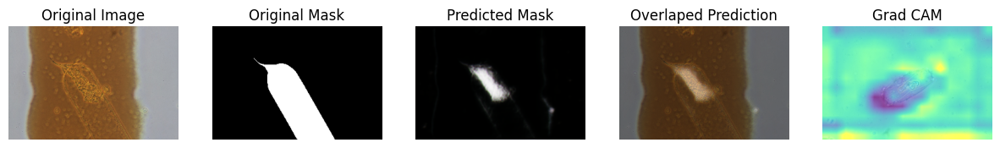

1/1 [==============================] - 0s 21ms/step


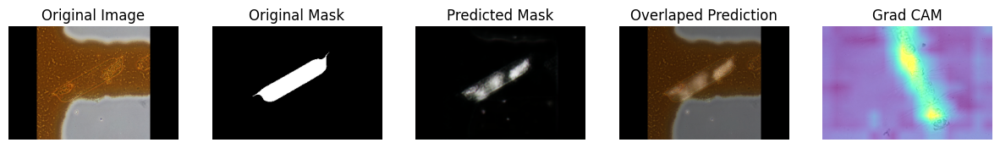

1/1 [==============================] - 0s 20ms/step


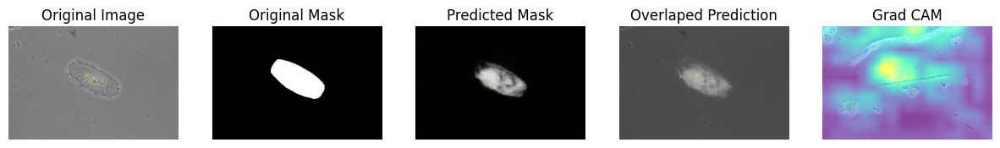

57/57 [==============================] - 6s 109ms/step - loss: 0.0553 - binary_io_u: 0.8623 - val_loss: 0.1037 - val_binary_io_u: 0.7944
Epoch 11/50
57/57 [==============================] - 3s 54ms/step - loss: 0.0607 - binary_io_u: 0.8465 - val_loss: 0.1762 - val_binary_io_u: 0.7224
Epoch 12/50
57/57 [==============================] - 3s 52ms/step - loss: 0.0519 - binary_io_u: 0.8678 - val_loss: 0.0758 - val_binary_io_u: 0.8384
Epoch 13/50
57/57 [==============================] - 3s 52ms/step - loss: 0.0469 - binary_io_u: 0.8819 - val_loss: 0.0998 - val_binary_io_u: 0.7906
Epoch 14/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0465 - binary_io_u: 0.8827 - val_loss: 0.0936 - val_binary_io_u: 0.8178
Epoch 15/50
1/1 [==============================] - 0s 21ms/steploss: 0.0418 - binary_io_u: 0.89


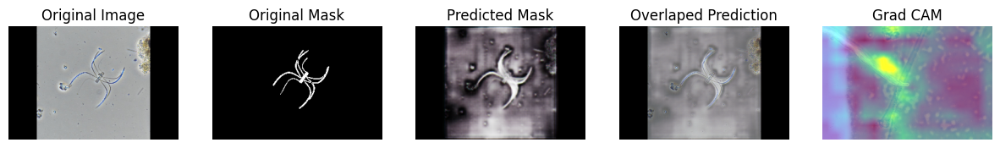

1/1 [==============================] - 0s 22ms/step


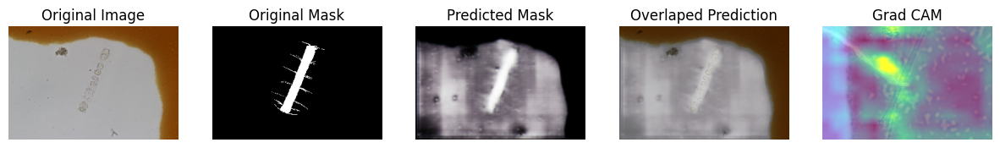

1/1 [==============================] - 0s 50ms/step


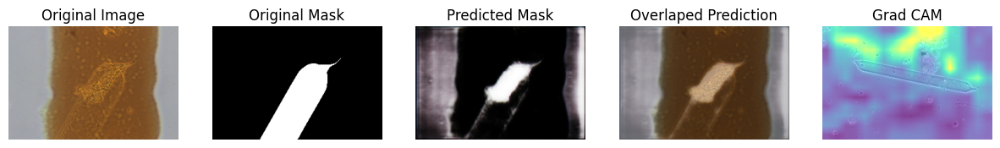

1/1 [==============================] - 0s 21ms/step


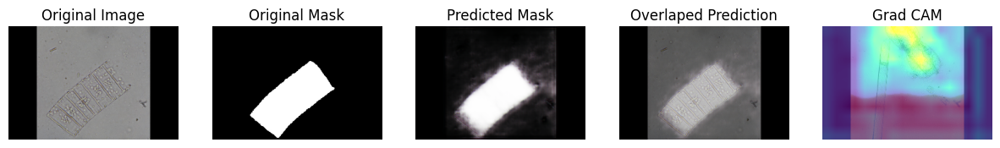

1/1 [==============================] - 0s 21ms/step


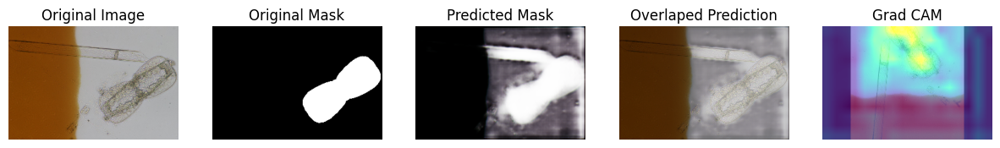

57/57 [==============================] - 7s 112ms/step - loss: 0.0418 - binary_io_u: 0.8932 - val_loss: 0.2619 - val_binary_io_u: 0.5991
Epoch 16/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0356 - binary_io_u: 0.9073 - val_loss: 0.0909 - val_binary_io_u: 0.8206
Epoch 17/50
57/57 [==============================] - 3s 54ms/step - loss: 0.0322 - binary_io_u: 0.9125 - val_loss: 0.1040 - val_binary_io_u: 0.8038
Epoch 18/50
57/57 [==============================] - 4s 53ms/step - loss: 0.0304 - binary_io_u: 0.9139 - val_loss: 0.0619 - val_binary_io_u: 0.8679
Epoch 19/50
57/57 [==============================] - 3s 52ms/step - loss: 0.0284 - binary_io_u: 0.9196 - val_loss: 0.0591 - val_binary_io_u: 0.8723
Epoch 20/50
1/1 [==============================] - 0s 21ms/steploss: 0.0328 - binary_io_u: 0.90


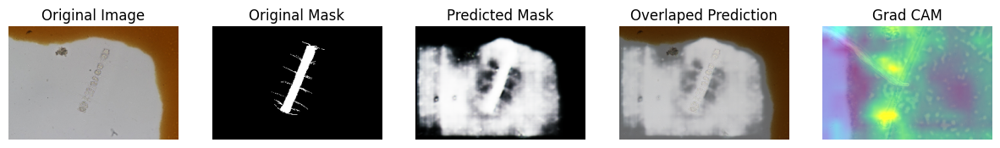

1/1 [==============================] - 0s 21ms/step


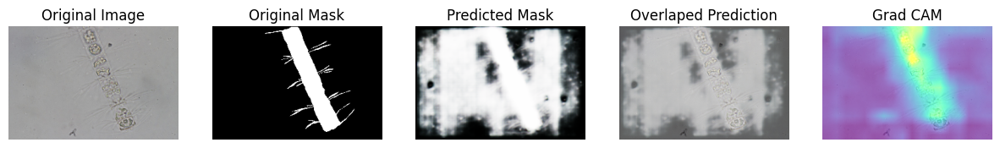

1/1 [==============================] - 0s 21ms/step


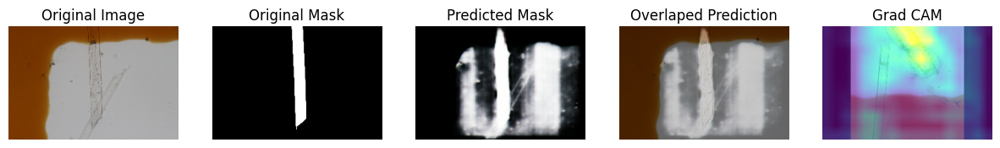

1/1 [==============================] - 0s 21ms/step


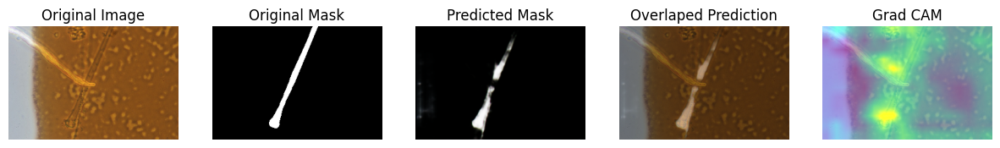

1/1 [==============================] - 0s 20ms/step


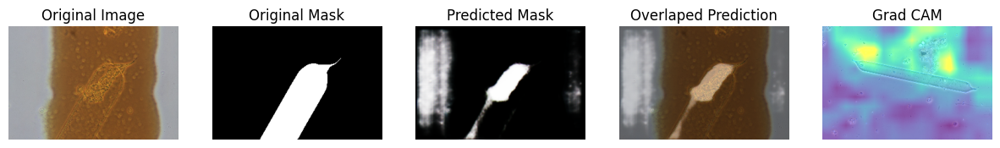

57/57 [==============================] - 6s 111ms/step - loss: 0.0328 - binary_io_u: 0.9091 - val_loss: 0.4304 - val_binary_io_u: 0.5689
Epoch 21/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0570 - binary_io_u: 0.8593 - val_loss: 0.3057 - val_binary_io_u: 0.6735
Epoch 22/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0342 - binary_io_u: 0.9093 - val_loss: 0.0799 - val_binary_io_u: 0.8564
Epoch 23/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0298 - binary_io_u: 0.9177 - val_loss: 0.0949 - val_binary_io_u: 0.8221
Epoch 24/50
57/57 [==============================] - 3s 52ms/step - loss: 0.0256 - binary_io_u: 0.9259 - val_loss: 0.0816 - val_binary_io_u: 0.8298
Epoch 25/50
1/1 [==============================] - 0s 21ms/steploss: 0.0225 - binary_io_u: 0.93


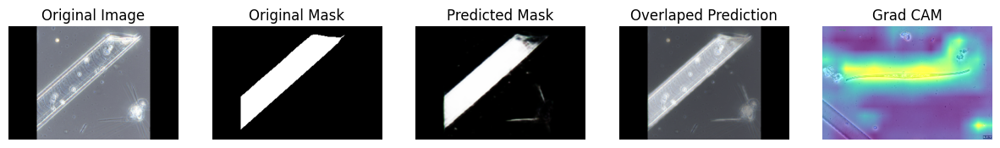

1/1 [==============================] - 0s 21ms/step


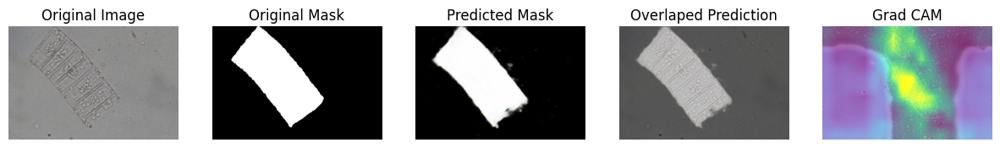

1/1 [==============================] - 0s 22ms/step


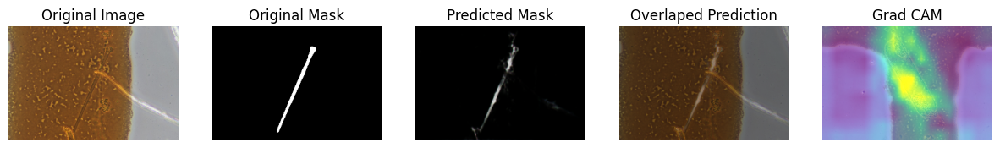

1/1 [==============================] - 0s 22ms/step


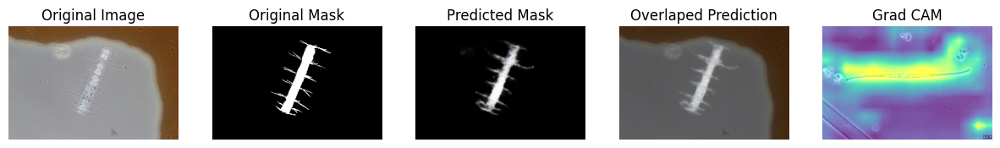

1/1 [==============================] - 0s 24ms/step


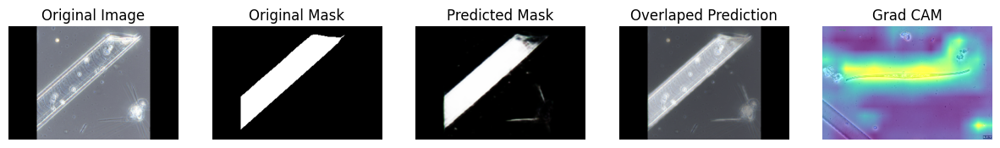

57/57 [==============================] - 7s 124ms/step - loss: 0.0225 - binary_io_u: 0.9303 - val_loss: 0.0512 - val_binary_io_u: 0.8885
Epoch 26/50
57/57 [==============================] - 3s 54ms/step - loss: 0.0202 - binary_io_u: 0.9341 - val_loss: 0.0501 - val_binary_io_u: 0.8910
Epoch 27/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0187 - binary_io_u: 0.9365 - val_loss: 0.0456 - val_binary_io_u: 0.9002
Epoch 28/50
57/57 [==============================] - 3s 54ms/step - loss: 0.0181 - binary_io_u: 0.9371 - val_loss: 0.0407 - val_binary_io_u: 0.9065
Epoch 29/50
57/57 [==============================] - 3s 54ms/step - loss: 0.0198 - binary_io_u: 0.9337 - val_loss: 0.0492 - val_binary_io_u: 0.8980
Epoch 30/50
1/1 [==============================] - 0s 22ms/steploss: 0.0174 - binary_io_u: 0.93


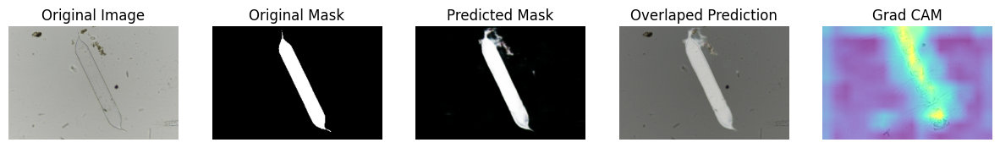

1/1 [==============================] - 0s 22ms/step


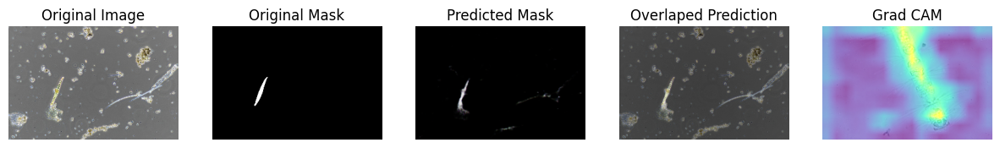

1/1 [==============================] - 0s 21ms/step


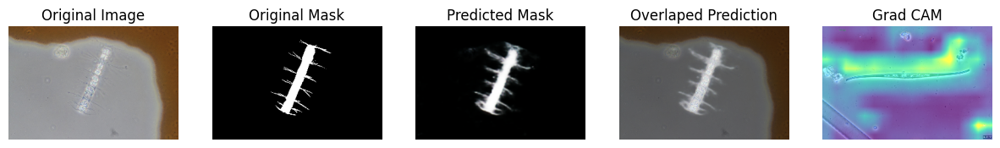

1/1 [==============================] - 0s 20ms/step


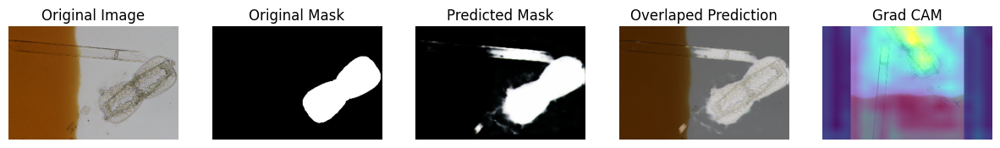

1/1 [==============================] - 0s 22ms/step


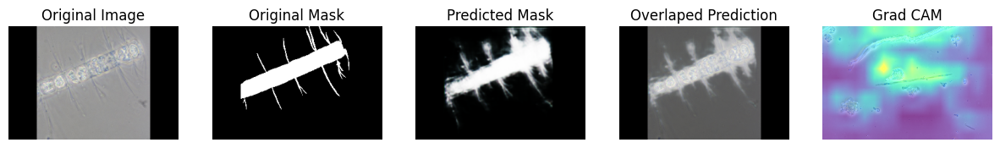

57/57 [==============================] - 6s 109ms/step - loss: 0.0174 - binary_io_u: 0.9382 - val_loss: 0.0615 - val_binary_io_u: 0.8789
Epoch 31/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0168 - binary_io_u: 0.9392 - val_loss: 0.0597 - val_binary_io_u: 0.8952
Epoch 32/50
57/57 [==============================] - 3s 54ms/step - loss: 0.0156 - binary_io_u: 0.9412 - val_loss: 0.0458 - val_binary_io_u: 0.9090
Epoch 33/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0156 - binary_io_u: 0.9410 - val_loss: 0.0591 - val_binary_io_u: 0.8953
Epoch 34/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0219 - binary_io_u: 0.9286 - val_loss: 0.0748 - val_binary_io_u: 0.8807
Epoch 35/50
1/1 [==============================] - 0s 23ms/steploss: 0.0300 - binary_io_u: 0.91


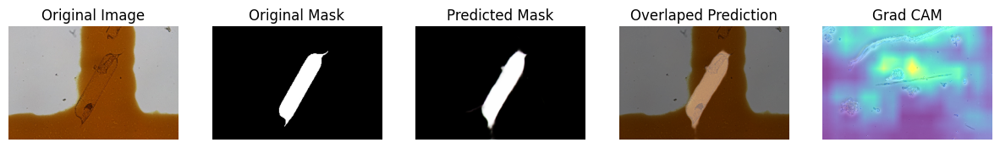

1/1 [==============================] - 0s 23ms/step


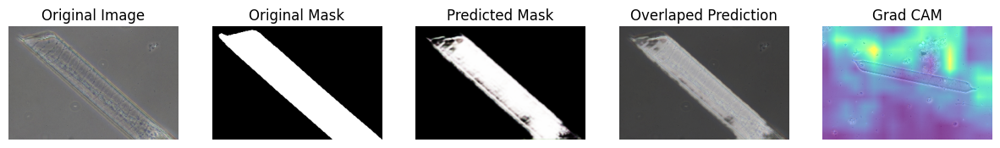

1/1 [==============================] - 0s 21ms/step


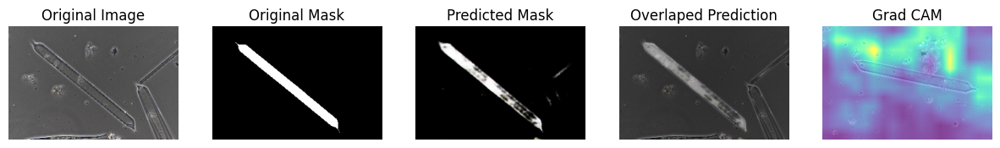

1/1 [==============================] - 0s 22ms/step


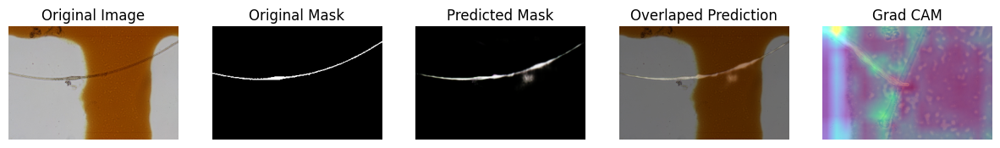

1/1 [==============================] - 0s 21ms/step


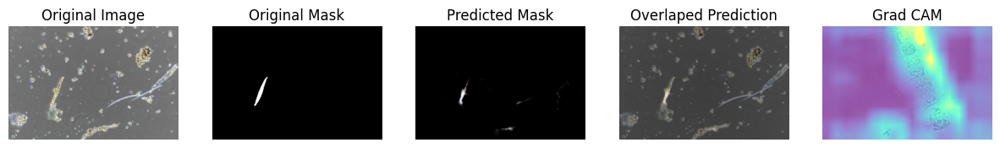

57/57 [==============================] - 7s 114ms/step - loss: 0.0300 - binary_io_u: 0.9130 - val_loss: 0.1204 - val_binary_io_u: 0.8322
Epoch 36/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0258 - binary_io_u: 0.9211 - val_loss: 0.0978 - val_binary_io_u: 0.8453
Epoch 37/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0210 - binary_io_u: 0.9315 - val_loss: 0.0671 - val_binary_io_u: 0.8860
Epoch 38/50
57/57 [==============================] - 3s 54ms/step - loss: 0.0173 - binary_io_u: 0.9385 - val_loss: 0.0557 - val_binary_io_u: 0.8947
Epoch 39/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0178 - binary_io_u: 0.9370 - val_loss: 0.0501 - val_binary_io_u: 0.8996
Epoch 40/50
1/1 [==============================] - 0s 20ms/steploss: 0.0149 - binary_io_u: 0.94


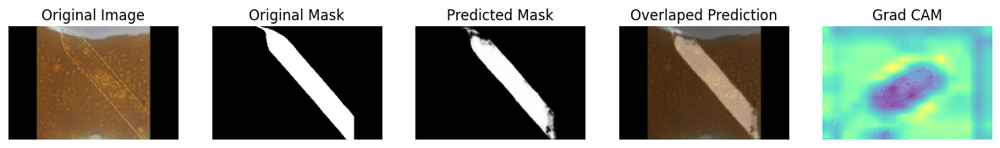

1/1 [==============================] - 0s 20ms/step


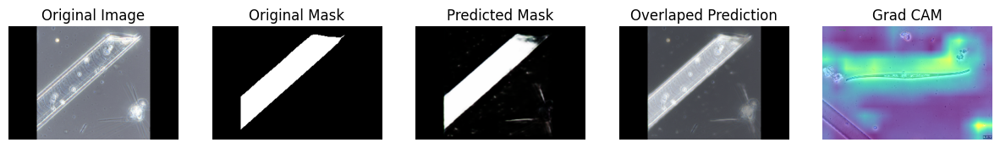

1/1 [==============================] - 0s 20ms/step


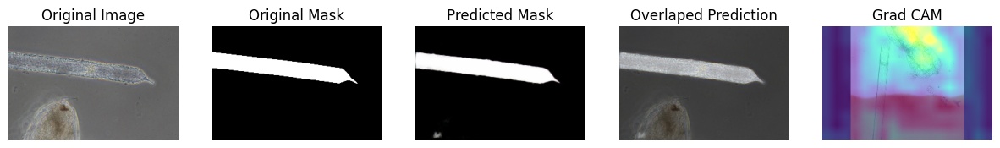

1/1 [==============================] - 0s 20ms/step


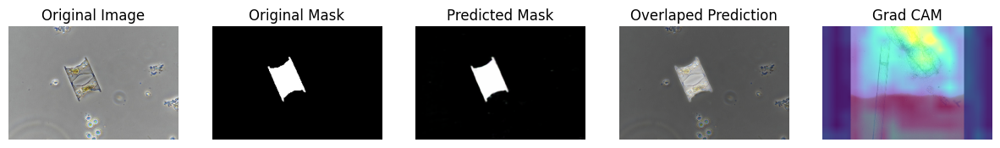

1/1 [==============================] - 0s 21ms/step


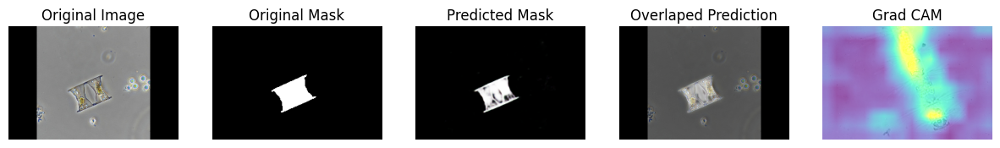

57/57 [==============================] - 6s 107ms/step - loss: 0.0149 - binary_io_u: 0.9420 - val_loss: 0.0443 - val_binary_io_u: 0.9035
Epoch 41/50
57/57 [==============================] - 3s 54ms/step - loss: 0.0135 - binary_io_u: 0.9443 - val_loss: 0.0964 - val_binary_io_u: 0.8271
Epoch 42/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0135 - binary_io_u: 0.9444 - val_loss: 0.0594 - val_binary_io_u: 0.8972
Epoch 43/50
57/57 [==============================] - 3s 54ms/step - loss: 0.0128 - binary_io_u: 0.9446 - val_loss: 0.0513 - val_binary_io_u: 0.8969
Epoch 44/50
57/57 [==============================] - 4s 55ms/step - loss: 0.0121 - binary_io_u: 0.9455 - val_loss: 0.0627 - val_binary_io_u: 0.8978
Epoch 45/50
1/1 [==============================] - 0s 20ms/steploss: 0.0132 - binary_io_u: 0.94


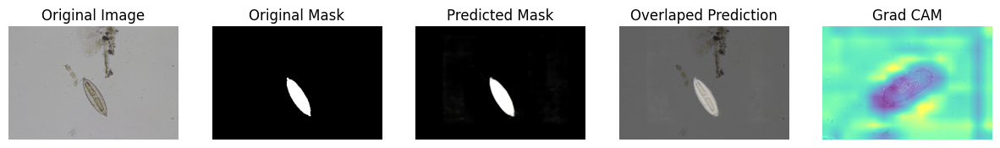

1/1 [==============================] - 0s 21ms/step


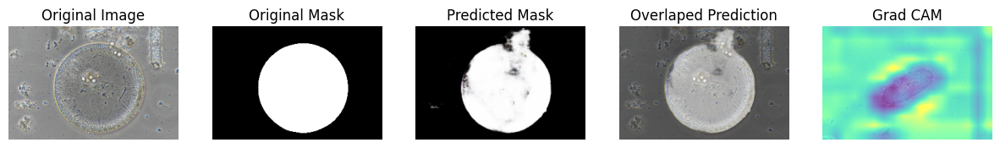

1/1 [==============================] - 0s 21ms/step


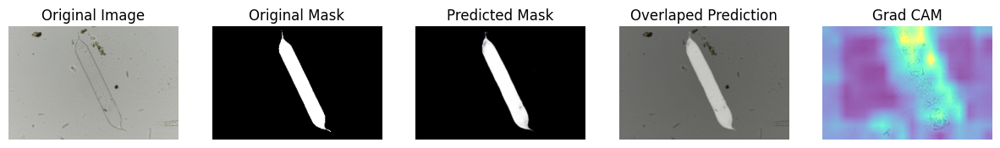

1/1 [==============================] - 0s 21ms/step


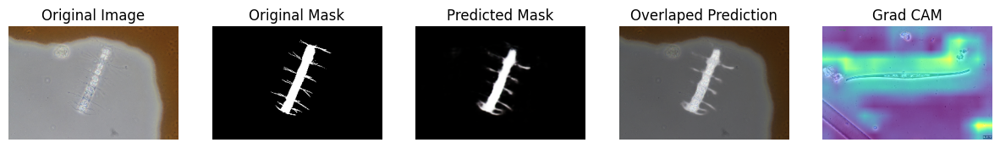

1/1 [==============================] - 0s 22ms/step


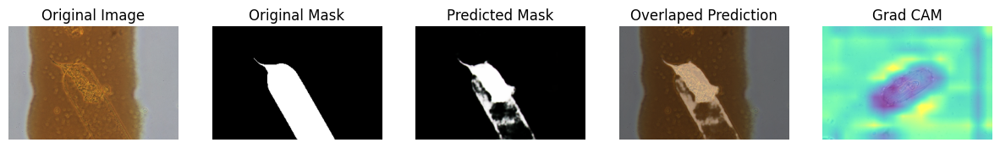

57/57 [==============================] - 7s 122ms/step - loss: 0.0132 - binary_io_u: 0.9444 - val_loss: 0.0471 - val_binary_io_u: 0.9074
Epoch 46/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0134 - binary_io_u: 0.9436 - val_loss: 0.0548 - val_binary_io_u: 0.8956
Epoch 47/50
57/57 [==============================] - 3s 53ms/step - loss: 0.0118 - binary_io_u: 0.9457 - val_loss: 0.0480 - val_binary_io_u: 0.9031
Epoch 48/50
57/57 [==============================] - 3s 52ms/step - loss: 0.0112 - binary_io_u: 0.9467 - val_loss: 0.0488 - val_binary_io_u: 0.9088
Epoch 49/50
57/57 [==============================] - 3s 55ms/step - loss: 0.0115 - binary_io_u: 0.9462 - val_loss: 0.0516 - val_binary_io_u: 0.9047
Epoch 50/50
1/1 [==============================] - 0s 21ms/steploss: 0.0125 - binary_io_u: 0.94


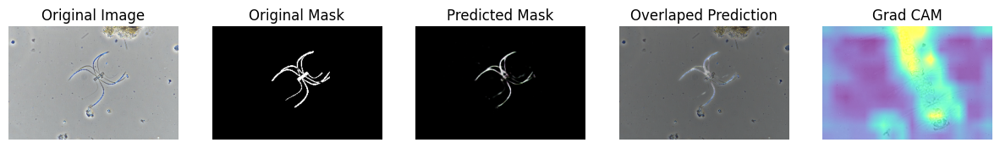

1/1 [==============================] - 0s 22ms/step


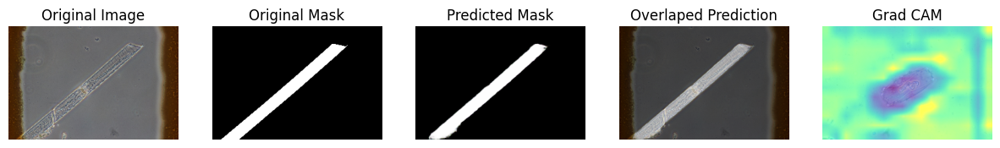

1/1 [==============================] - 0s 21ms/step


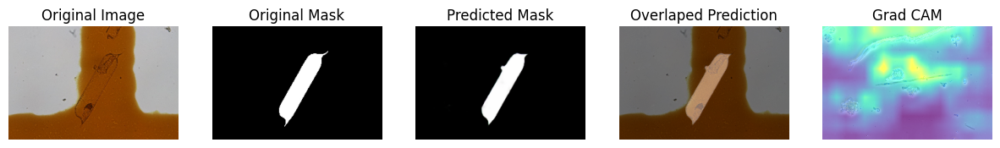

1/1 [==============================] - 0s 21ms/step


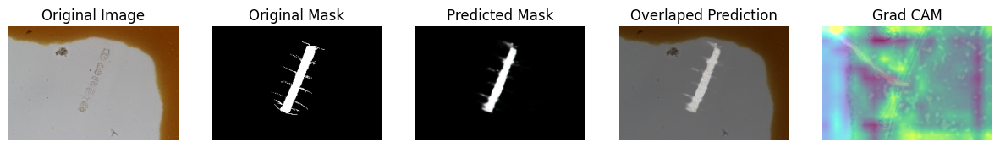

1/1 [==============================] - 0s 21ms/step


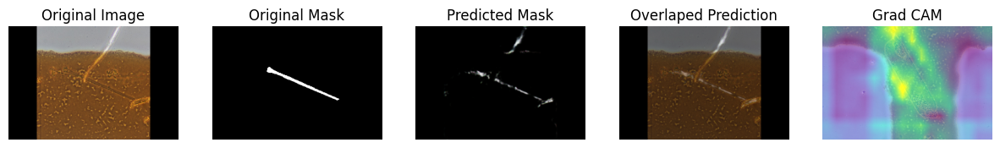

57/57 [==============================] - 6s 110ms/step - loss: 0.0125 - binary_io_u: 0.9453 - val_loss: 0.0547 - val_binary_io_u: 0.9048


In [52]:
optimizer = tfk.optimizers.Adam(learning_rate=1e-3)

model.compile(
    loss='binary_crossentropy',
    metrics=[tfk.metrics.BinaryIoU(threshold=0.5, name=None, dtype=None, target_class_ids=(0, 1))],
    optimizer=optimizer
)

class ShowProgress(Callback):
    def on_epoch_end(self, epoch, logs=None):
        if (epoch+1)%5==0:
            show_images(valid_ds, model=self.model, explain=True, n_images=5, SIZE=(15, 8))

callbacks = [
    ModelCheckpoint("UNet.keras"), 
    ShowProgress(),
]

history = model.fit(train_ds, validation_data=valid_ds, epochs=50, callbacks=callbacks)

## **U-Net Model Evaluation**

In [53]:
score = model.evaluate(test_ds)
print("Loss: ", score[0])
print("IoU: ", score[1])

2/2 [==============================] - 0s 33ms/step - loss: 0.0591 - binary_io_u: 0.8979
Loss:  0.05911665037274361
IoU:  0.8978558778762817


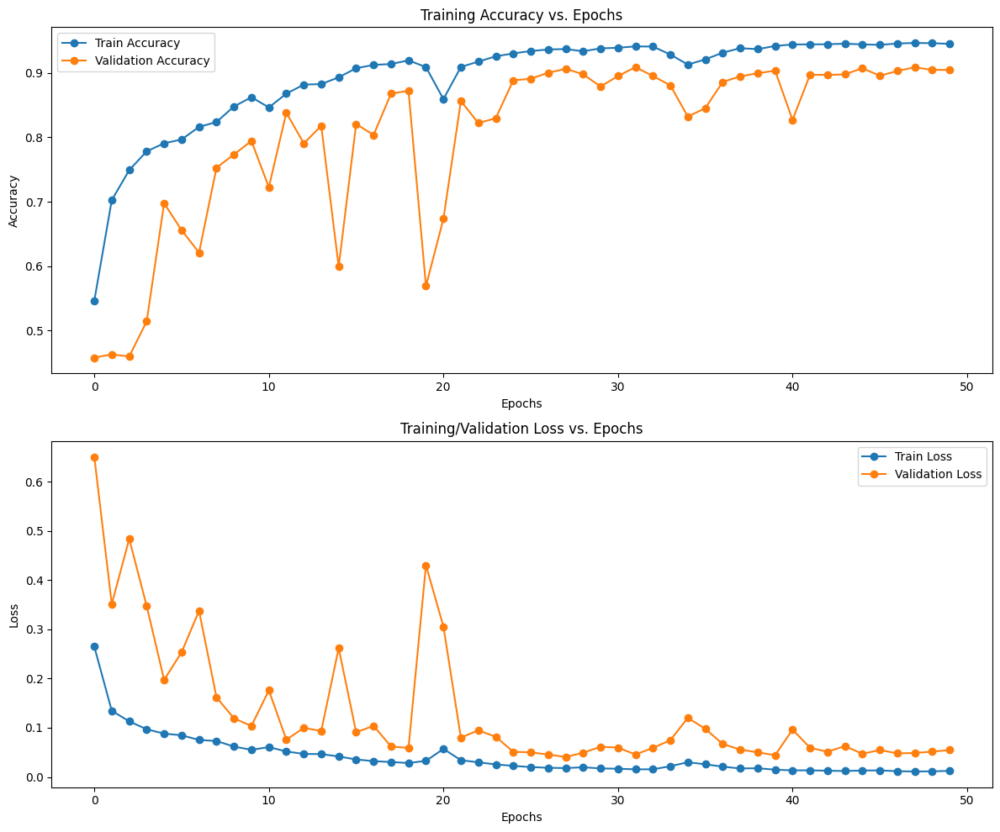

In [54]:
train_accuracy = history.history['binary_io_u']
val_accuracy = history.history['val_binary_io_u']
train_loss = history.history['loss']
val_loss = history.history['val_loss']

fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(12, 10))

ax[0].set_title('Training Accuracy vs. Epochs')
ax[0].plot(train_accuracy, 'o-', label='Train Accuracy')
ax[0].plot(val_accuracy, 'o-', label='Validation Accuracy')
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('Accuracy')
ax[0].legend(loc='best')

ax[1].set_title('Training/Validation Loss vs. Epochs')
ax[1].plot(train_loss, 'o-', label='Train Loss')
ax[1].plot(val_loss, 'o-', label='Validation Loss')
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Loss')
ax[1].legend(loc='best')

plt.tight_layout()
plt.show()

In [55]:
model.save('U-Net')

1/1 [==============================] - 0s 21ms/step


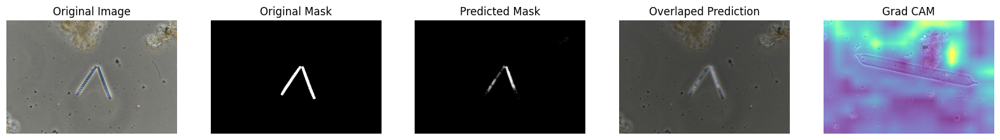

1/1 [==============================] - 0s 20ms/step


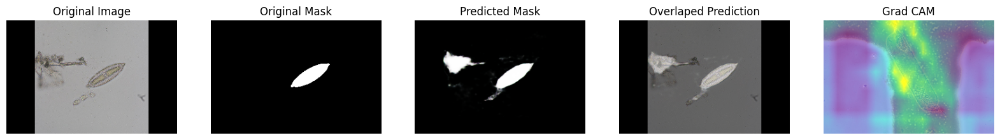

1/1 [==============================] - 0s 21ms/step


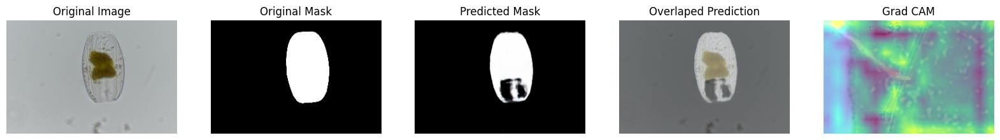

1/1 [==============================] - 0s 21ms/step


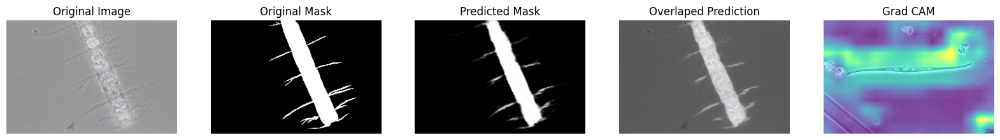

1/1 [==============================] - 0s 21ms/step


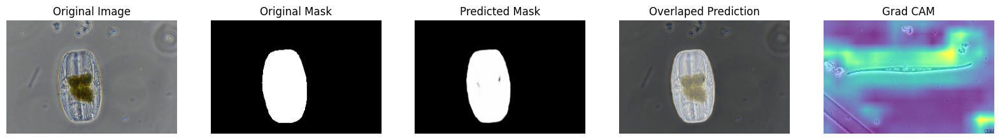

1/1 [==============================] - 0s 22ms/step


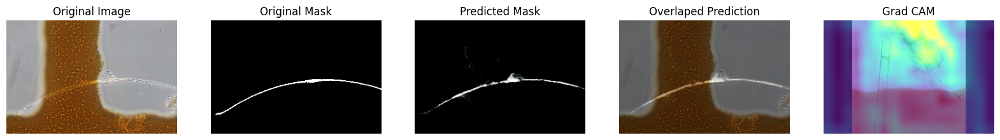

1/1 [==============================] - 0s 22ms/step


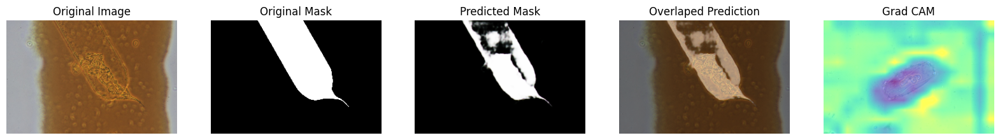

1/1 [==============================] - 0s 21ms/step


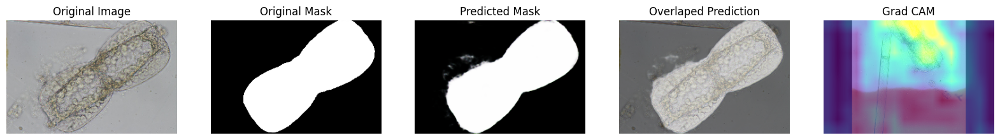

1/1 [==============================] - 0s 20ms/step


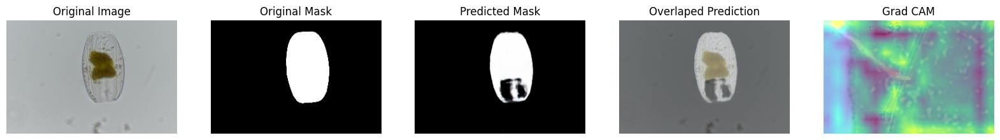

1/1 [==============================] - 0s 20ms/step


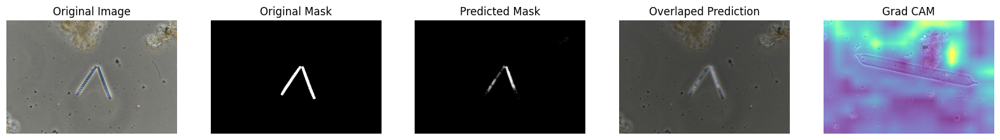

In [57]:
show_images(test_ds, model=model, explain=True, n_images=10, SIZE=(20, 8))

## **U-Net Test Model**

In [58]:
!tar -zcvf U-Net.tar.gz /kaggle/working/U-Net

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


tar: Removing leading `/' from member names
/kaggle/working/U-Net/
/kaggle/working/U-Net/variables/
/kaggle/working/U-Net/variables/variables.index
/kaggle/working/U-Net/variables/variables.data-00000-of-00001
/kaggle/working/U-Net/fingerprint.pb
/kaggle/working/U-Net/keras_metadata.pb
/kaggle/working/U-Net/saved_model.pb
/kaggle/working/U-Net/assets/


1/1 [==============================] - 2s 2s/step


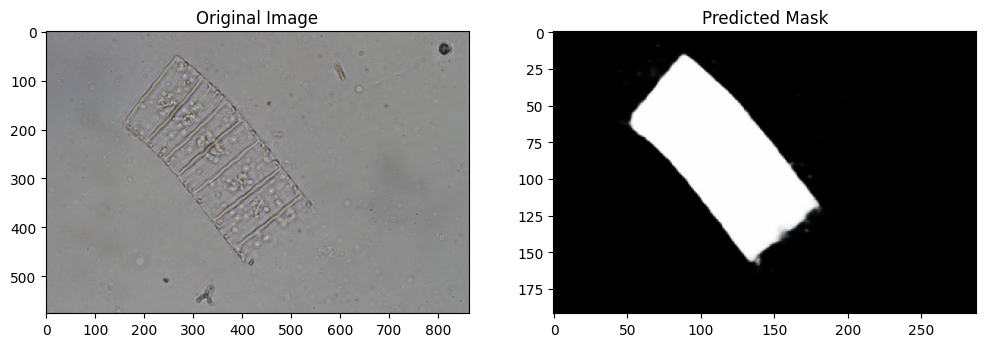

In [59]:
def load_image_for_prediction(path, IMAGE_SIZE=(192, 288)):
    image = load_img(path)
    image = img_to_array(image)
    image = tfi.resize(image, IMAGE_SIZE)
    image = tf.cast(image, tf.float32)
    image = image / 255.0
    return image

def predict_mask(model, image_path, IMAGE_SIZE=(192, 288)):
    image = load_image_for_prediction(image_path, IMAGE_SIZE=IMAGE_SIZE)
    predicted_mask = model.predict(image[np.newaxis, ...])[0]
    return predicted_mask

def visualize_prediction(image_path, predicted_mask):
    original_image = load_img(image_path)
    
    plt.figure(figsize=(12, 5))
    
    plt.subplot(1, 2, 1)
    plt.imshow(original_image)
    plt.title("Original Image")
    
    plt.subplot(1, 2, 2)
    plt.imshow(predicted_mask, cmap='gray')
    plt.title("Predicted Mask")
    
    plt.show()

l_model = tfk.models.load_model('/kaggle/working/U-Net')
img_path = "/kaggle/input/image-and-mask-pythoplankton-dataset/segmentation/image/Achnanthes sp 1_blur.jpg"
predicted_mask = predict_mask(l_model, img_path)
visualize_prediction(img_path, predicted_mask)